# Predictions on Clinic Images

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
from PIL import Image
import torchvision.transforms as transforms
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader
from torch.optim import Adam

from GlaucomaDataset import GlaucomaDataset
from unet import UNet

In [2]:
def dice_coefficient(targets, preds, smooth=1e-6):
    # preds = (preds > 0.5).float 
    intersection = torch.sum(preds * targets, dim=(2,3))
    # want close to 1 (identical)
    dice = (2. * intersection + smooth) / (torch.sum(preds, dim=(2,3)) + torch.sum(targets, dim=(2,3)) + smooth)
    return dice.mean()

In [3]:
from torch import nn

class BCEDiceLoss(nn.Module):
    def __init__(self, bce_weight=0.5, dice_weight=0.5, smooth=1e-5):
        super(BCEDiceLoss, self).__init__()
        self.bce_loss = torch.nn.BCELoss(reduction='mean')
        self.bce_weight = bce_weight
        self.dice_weight = dice_weight
        self.smooth = smooth
        
    def dice(self, pred, target):
        """Computes dice loss"""
        # Sums on channel, height, width dimensions 
        while pred.dim() < 4:
            pred = pred.unsqueeze(0)
        while target.dim() < 4: 
            target = target.unsqueeze(0)
            
        intersection = (pred * target).sum(dim=(2, 3))
        union = pred.sum(dim=(2, 3)) + target.sum(dim=(2, 3))
        dice = (2. * intersection + self.smooth) / (union + self.smooth)
        return 1 - dice.mean()
    
    def forward(self, preds, target):
        """Computes hybrid BCE and dice loss"""
        bce = self.bce_loss(preds, target)
        dice = self.dice(preds, target)
        loss = bce * self.bce_weight + dice * self.dice_weight
        return loss

In [4]:
def predict(image, model, device, plot=True):
    image = image.unsqueeze(0).to(device)

    with torch.no_grad():
        pred = model(image)

    pred = pred.squeeze(0).cpu().numpy()
    pred_od = pred[0]
    pred_oc = pred[1]

    pred_od = (pred_od > 0.5).astype(int)
    pred_oc = (pred_oc > 0.5).astype(int)

    if plot:
        image = image.squeeze().cpu().numpy().transpose(1,2,0)
        fig, ax = plt.subplots(1, 3, figsize=(6, 2))
        ax[0].imshow(image)
        ax[0].set_title("Input Image")
        ax[1].imshow(pred_od, cmap='gray')  # Optic Disc
        ax[1].set_title("Predicted OD")
        ax[2].imshow(pred_oc, cmap='gray')  # Optic Cup
        ax[2].set_title("Predicted OC")
        plt.show()

    return pred_od, pred_oc

### Process all clinic images

In [5]:
# Read in image files 
clinic_path = os.path.join("..", "data", "Clinic")
subject1_cd1_path = os.path.join(clinic_path, "Subject_1_CD_1")
subject1_cd2_path = os.path.join(clinic_path, "Subject_1_CD_2")

cd1_filenames = sorted(os.listdir(subject1_cd1_path))
cd2_filenames = sorted(os.listdir(subject1_cd2_path))

In [6]:
# Pre-processing 
images_cd1 = []
for img in cd1_filenames:
    img_name = os.path.join(subject1_cd1_path, img)
    img = np.array(Image.open(img_name).convert('RGB')) 
    img = transforms.functional.to_tensor(img)
    img = transforms.functional.resize(img, size=(256,256), interpolation=Image.BILINEAR)
    images_cd1.append(img)

images_cd2 = []
for img in cd2_filenames:
    img_name = os.path.join(subject1_cd2_path, img)
    img = np.array(Image.open(img_name).convert('RGB'))
    img = transforms.functional.to_tensor(img)
    img = transforms.functional.resize(img, size=(256,256), interpolation=Image.BILINEAR)
    images_cd2.append(img)

### Model 1 (Normal Loss)

In [8]:
# Load in model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNet(in_channels=3).to(device)
path = os.path.join(os.getcwd(), "model_state_dict.pth")

if device.type == 'cuda':
    model.load_state_dict(torch.load(path, weights_only=True))
else:
    model.load_state_dict(torch.load(path, weights_only=True, map_location=torch.device('cpu')))

Top 3 predictions from video 1:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


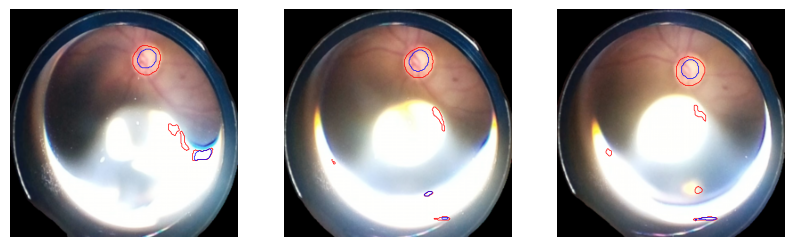

In [9]:
pred_od1, pred_oc1 = predict(images_cd1[5], model, device, plot=False)
img1 = images_cd1[5].squeeze().cpu().numpy().transpose(1,2,0)

pred_od2, pred_oc2 = predict(images_cd1[8], model, device, plot=False)
img2 = images_cd1[8].squeeze().cpu().numpy().transpose(1,2,0)

pred_od3, pred_oc3 = predict(images_cd1[15], model, device, plot=False)
img3 = images_cd1[15].squeeze().cpu().numpy().transpose(1,2,0)

fig, ax = plt.subplots(1, 3, figsize=(10,10))
ax[0].imshow(img1)
ax[0].contour(pred_od1, levels=[0.5], colors="red", linewidths=0.5)
ax[0].contour(pred_oc1, levels=[0.5], colors="blue", linewidths=0.5)
ax[0].axis("off")

ax[1].imshow(img2)
ax[1].contour(pred_od2, levels=[0.5], colors="red", linewidths=0.5)
ax[1].contour(pred_oc2, levels=[0.5], colors="blue", linewidths=0.5)
ax[1].axis("off")

ax[2].imshow(img3)
ax[2].contour(pred_od3, levels=[0.5], colors="red", linewidths=0.5)
ax[2].contour(pred_oc3, levels=[0.5], colors="blue", linewidths=0.5)
ax[2].axis("off")

plt.show()

Top 3 predictions from video 2:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


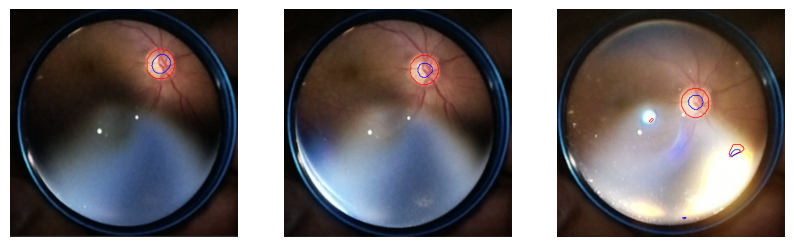

In [10]:
pred_od1, pred_oc1 = predict(images_cd2[2], model, device, plot=False)
img1 = images_cd2[2].squeeze().cpu().numpy().transpose(1,2,0)

pred_od2, pred_oc2 = predict(images_cd2[3], model, device, plot=False)
img2 = images_cd2[3].squeeze().cpu().numpy().transpose(1,2,0)

pred_od3, pred_oc3 = predict(images_cd2[5], model, device, plot=False)
img3 = images_cd2[5].squeeze().cpu().numpy().transpose(1,2,0)

fig, ax = plt.subplots(1, 3, figsize=(10,10))
ax[0].imshow(img1)
ax[0].contour(pred_od1, levels=[0.5], colors="red", linewidths=0.5)
ax[0].contour(pred_oc1, levels=[0.5], colors="blue", linewidths=0.5)
ax[0].axis("off")

ax[1].imshow(img2)
ax[1].contour(pred_od2, levels=[0.5], colors="red", linewidths=0.5)
ax[1].contour(pred_oc2, levels=[0.5], colors="blue", linewidths=0.5)
ax[1].axis("off")

ax[2].imshow(img3)
ax[2].contour(pred_od3, levels=[0.5], colors="red", linewidths=0.5)
ax[2].contour(pred_oc3, levels=[0.5], colors="blue", linewidths=0.5)
ax[2].axis("off")
plt.savefig("subject1_model1_preds.png", bbox_inches='tight', dpi=300)
plt.show()

### Model 2 (Hybrid Loss)

In [11]:
# Load in model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNet(in_channels=3).to(device)
path = os.path.join(os.getcwd(), "model_hybrid_state_dict.pth")
loss_func = BCEDiceLoss(bce_weight=0.5, dice_weight=0.5)

if device.type == 'cuda':
    model.load_state_dict(torch.load(path, weights_only=True))
else:
    model.load_state_dict(torch.load(path, weights_only=True, map_location=torch.device('cpu')))

Top three predictions from video 1:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


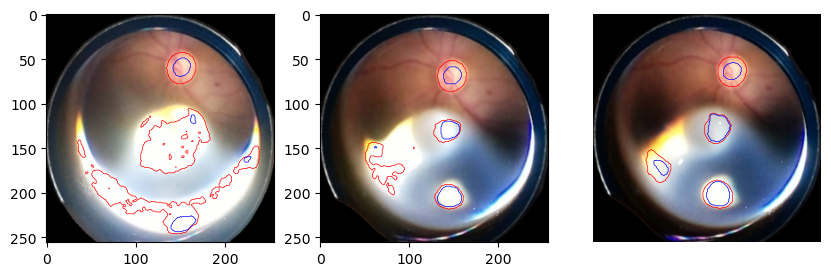

In [12]:
pred_od1, pred_oc1 = predict(images_cd1[8], model, device, plot=False)
img1 = images_cd1[8].squeeze().cpu().numpy().transpose(1,2,0)

pred_od2, pred_oc2 = predict(images_cd1[17], model, device, plot=False)
img2 = images_cd1[17].squeeze().cpu().numpy().transpose(1,2,0)

pred_od3, pred_oc3 = predict(images_cd1[23], model, device, plot=False)
img3 = images_cd1[23].squeeze().cpu().numpy().transpose(1,2,0)

fig, ax = plt.subplots(1, 3, figsize=(10,10))
ax[0].imshow(img1)
ax[0].contour(pred_od1, levels=[0.5], colors="red", linewidths=0.5)
ax[0].contour(pred_oc1, levels=[0.5], colors="blue", linewidths=0.5)

ax[1].imshow(img2)
ax[1].contour(pred_od2, levels=[0.5], colors="red", linewidths=0.5)
ax[1].contour(pred_oc2, levels=[0.5], colors="blue", linewidths=0.5)

ax[2].imshow(img3)
ax[2].contour(pred_od3, levels=[0.5], colors="red", linewidths=0.5)
ax[2].contour(pred_oc3, levels=[0.5], colors="blue", linewidths=0.5)

plt.axis("off")
plt.show()

Top predictions from video 2:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


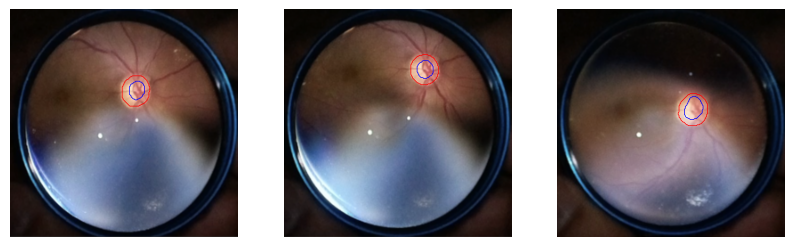

In [13]:
pred_od1, pred_oc1 = predict(images_cd2[1], model, device, plot=False)
img1 = images_cd2[1].squeeze().cpu().numpy().transpose(1,2,0)

pred_od2, pred_oc2 = predict(images_cd2[3], model, device, plot=False)
img2 = images_cd2[3].squeeze().cpu().numpy().transpose(1,2,0)

pred_od3, pred_oc3 = predict(images_cd2[6], model, device, plot=False)
img3 = images_cd2[6].squeeze().cpu().numpy().transpose(1,2,0)

fig, ax = plt.subplots(1, 3, figsize=(10,10))
ax[0].imshow(img1)
ax[0].contour(pred_od1, levels=[0.5], colors="red", linewidths=0.5)
ax[0].contour(pred_oc1, levels=[0.5], colors="blue", linewidths=0.5)
ax[0].axis("off")

ax[1].imshow(img2)
ax[1].contour(pred_od2, levels=[0.5], colors="red", linewidths=0.5)
ax[1].contour(pred_oc2, levels=[0.5], colors="blue", linewidths=0.5)
ax[1].axis("off")

ax[2].imshow(img3)
ax[2].contour(pred_od3, levels=[0.5], colors="red", linewidths=0.5)
ax[2].contour(pred_oc3, levels=[0.5], colors="blue", linewidths=0.5)
ax[2].axis("off")
plt.savefig("subject1_model2_preds.png", bbox_inches='tight', dpi=300)
plt.show()

## Subject 2

In [20]:
# Read in image files 
clinic_path = os.path.join("..", "data", "Clinic")
subject2_path = os.path.join(clinic_path, "Subject-2")

subj2_filenames = sorted(os.listdir(subject2_path))
subj2_filenames.remove('.DS_Store')

# Pre-processing 
images_subj2 = []
for img in subj2_filenames:
    img_name = os.path.join(subject2_path, img)
    img = np.array(Image.open(img_name).convert('RGB')) 
    img = transforms.functional.to_tensor(img)
    img = transforms.functional.resize(img, size=(256,256), interpolation=Image.BILINEAR)
    images_subj2.append(img)

Image index: 0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


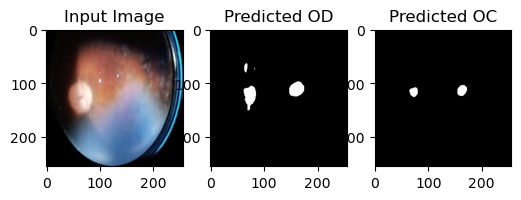

Image index: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


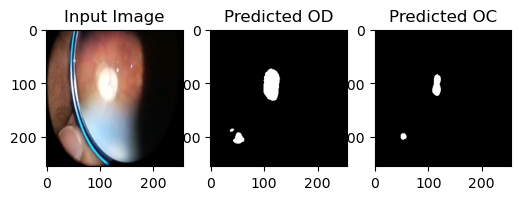

Image index: 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


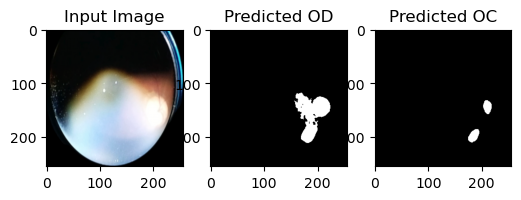

Image index: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


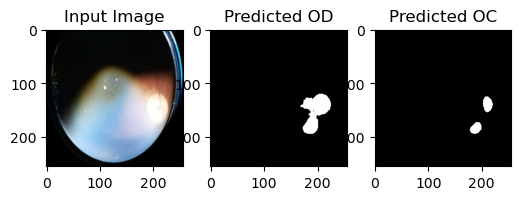

Image index: 4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


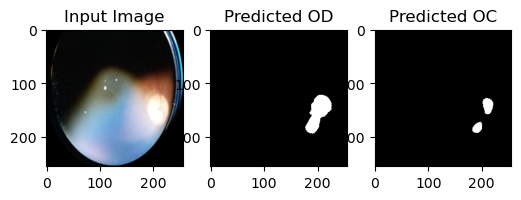

Image index: 5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


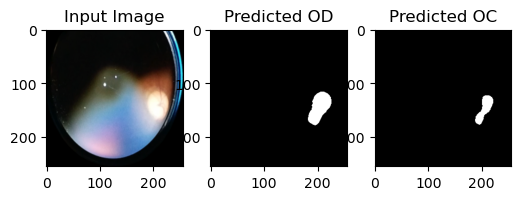

Image index: 6


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


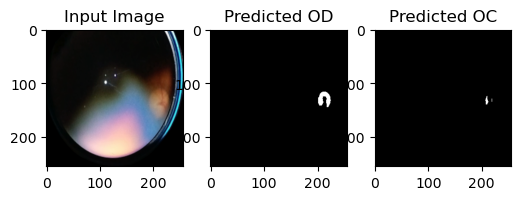

Image index: 7


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


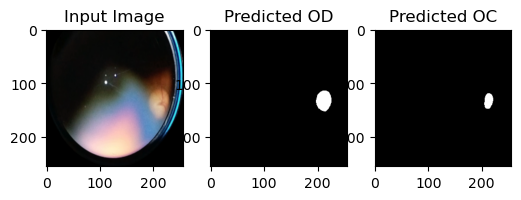

Image index: 8


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


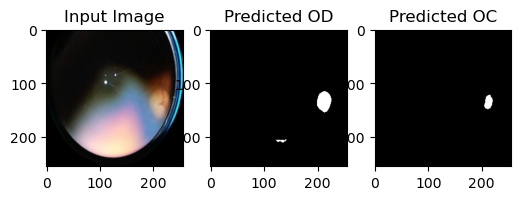

Image index: 9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


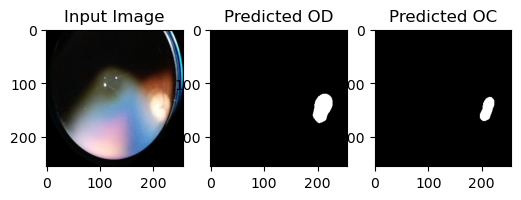

Image index: 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


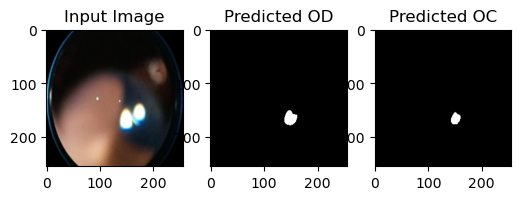

Image index: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


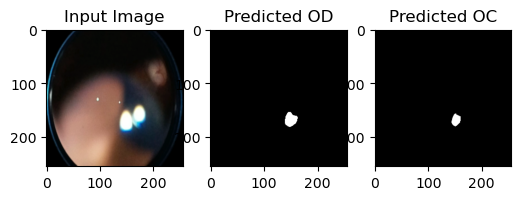

Image index: 12


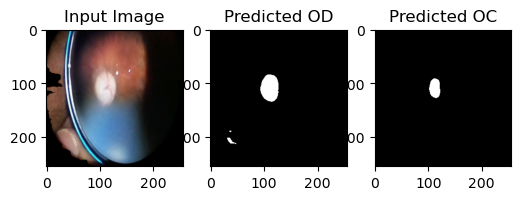

Image index: 13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


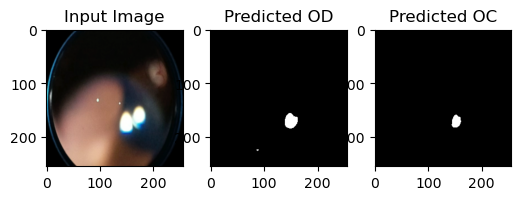

Image index: 14


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


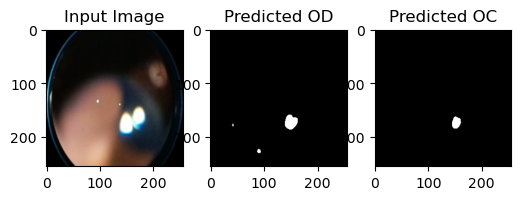

Image index: 15


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


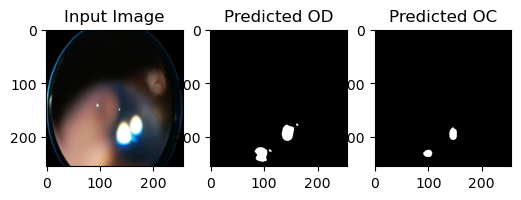

Image index: 16


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


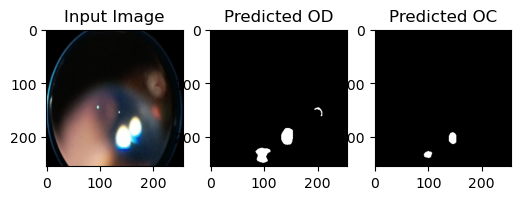

Image index: 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


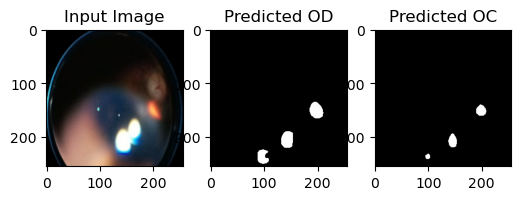

Image index: 18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


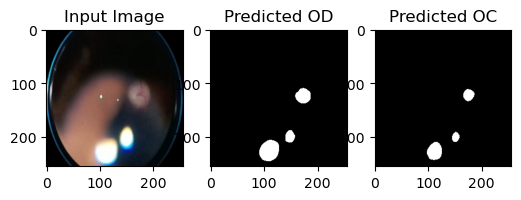

Image index: 19


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


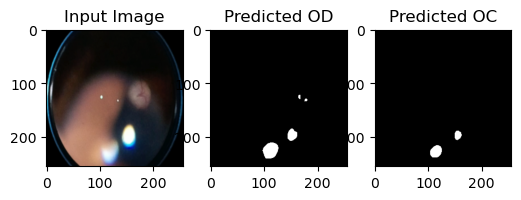

Image index: 20


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


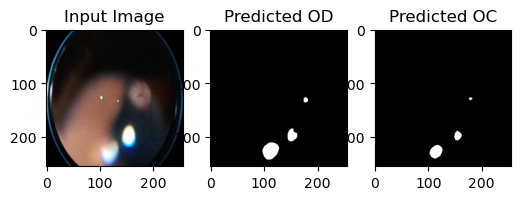

Image index: 21


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


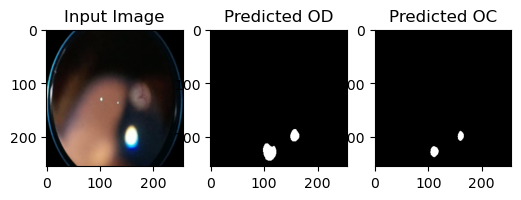

Image index: 22


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


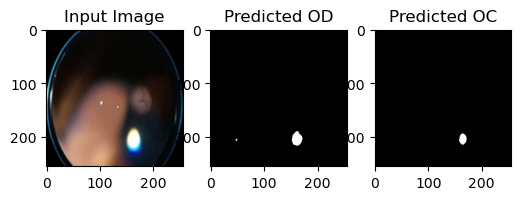

Image index: 23


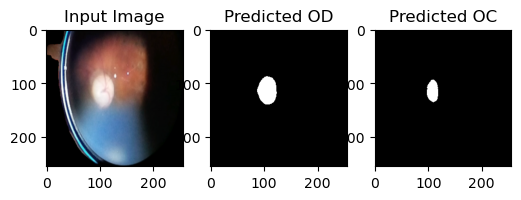

Image index: 24


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


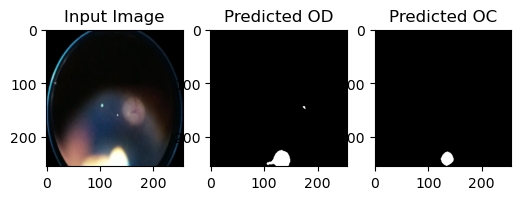

Image index: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


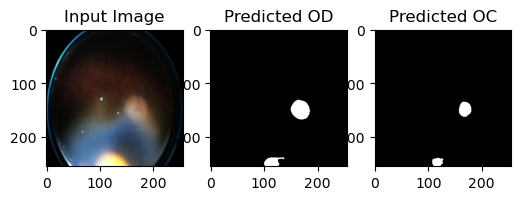

Image index: 26


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


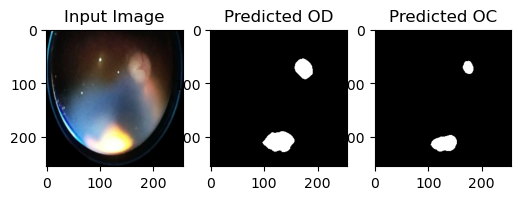

Image index: 27


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


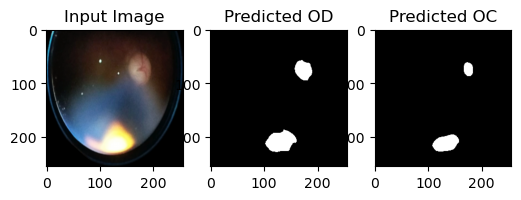

Image index: 28


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


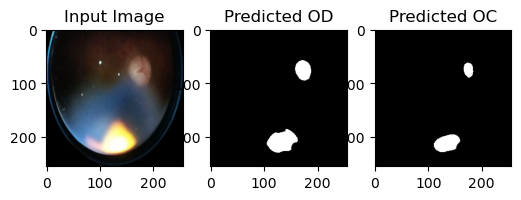

Image index: 29


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


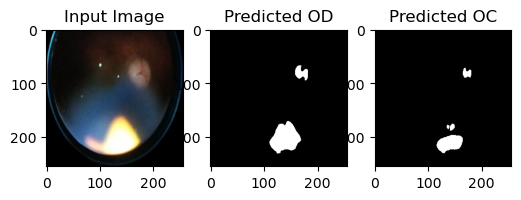

Image index: 30


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


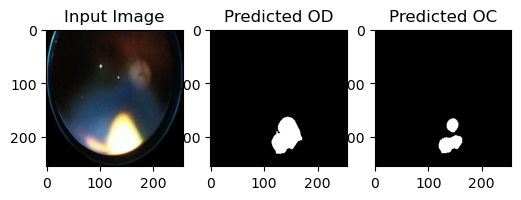

Image index: 31


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


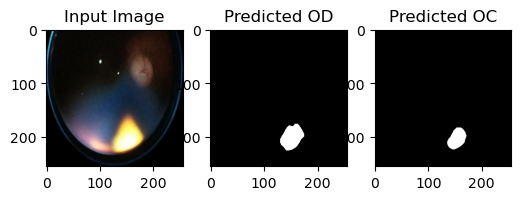

Image index: 32


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


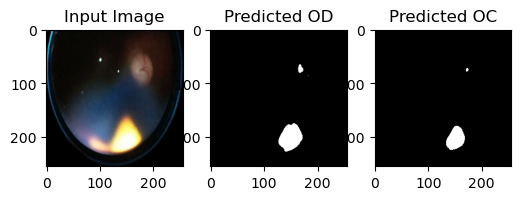

Image index: 33


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


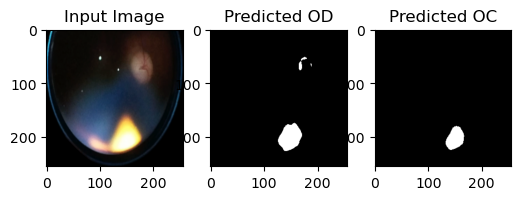

Image index: 34


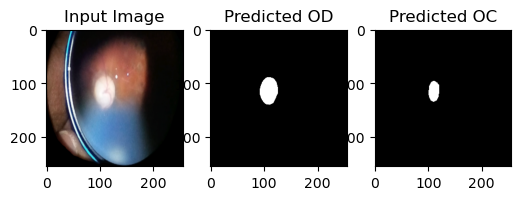

Image index: 35


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


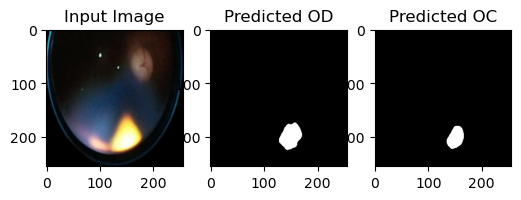

Image index: 36


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


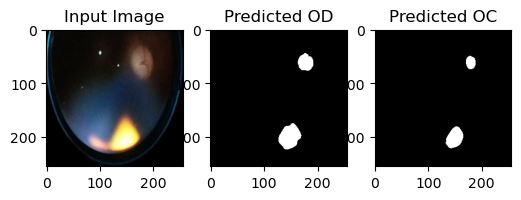

Image index: 37


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


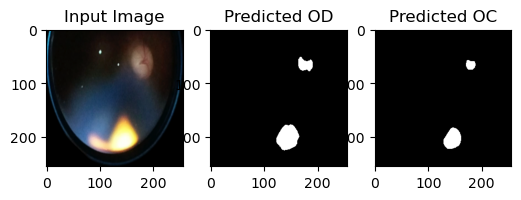

Image index: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


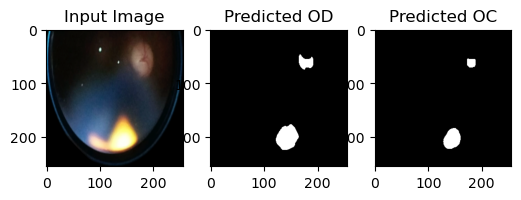

Image index: 39


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


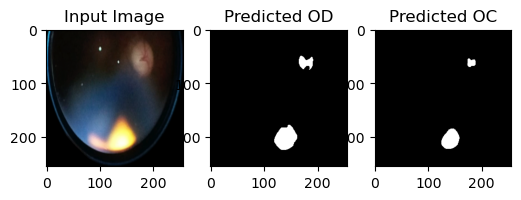

Image index: 40


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


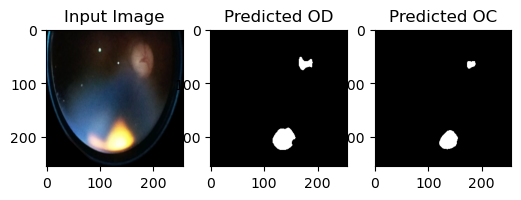

Image index: 41


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


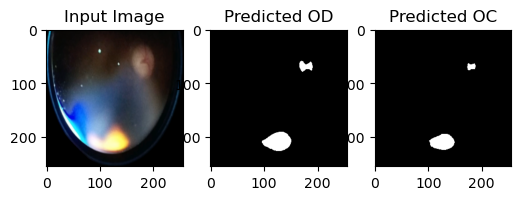

Image index: 42


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


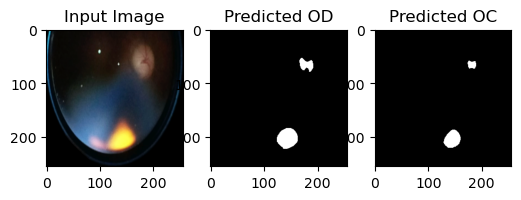

Image index: 43


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


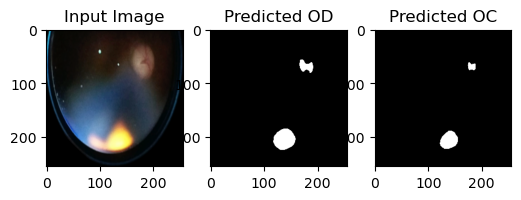

Image index: 44


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


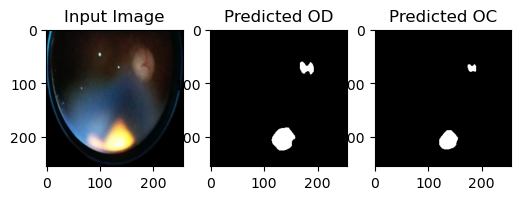

Image index: 45


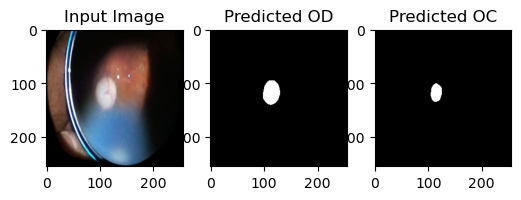

Image index: 46


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


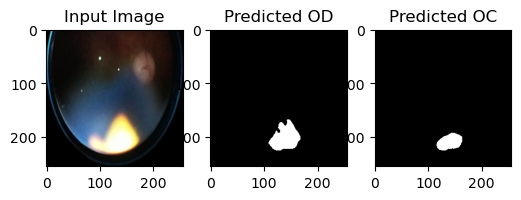

Image index: 47


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


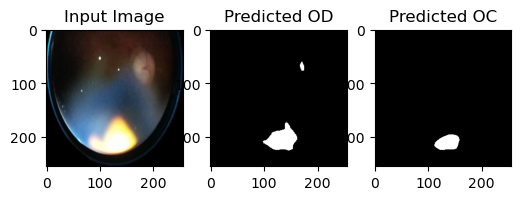

Image index: 48


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


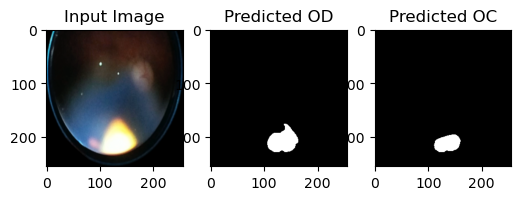

Image index: 49


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


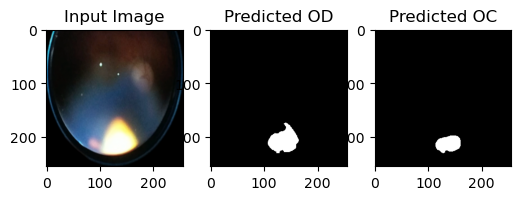

Image index: 50


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


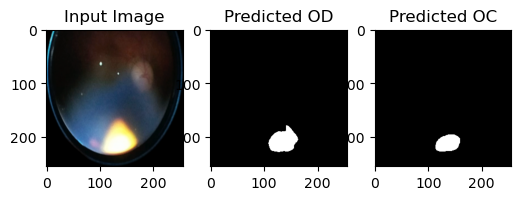

Image index: 51


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


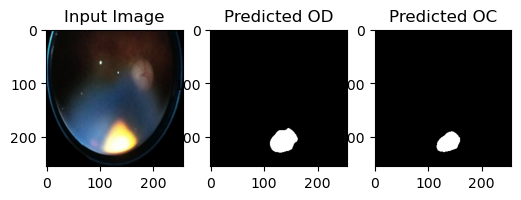

Image index: 52


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


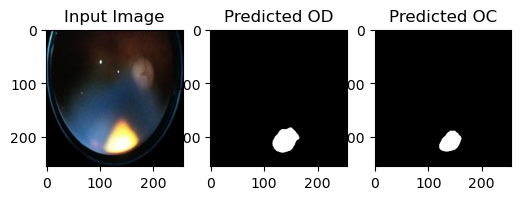

Image index: 53


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


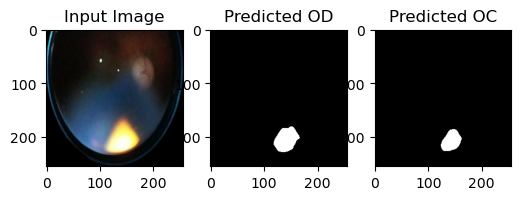

Image index: 54


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


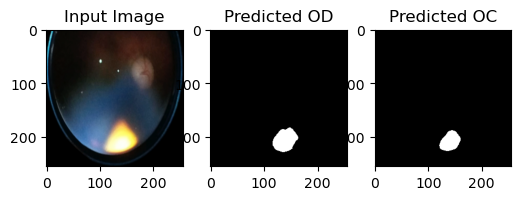

Image index: 55


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


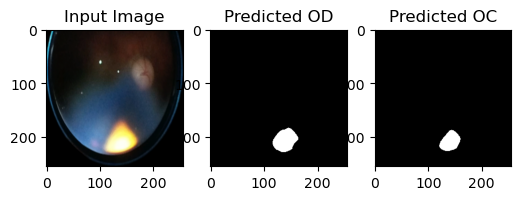

Image index: 56


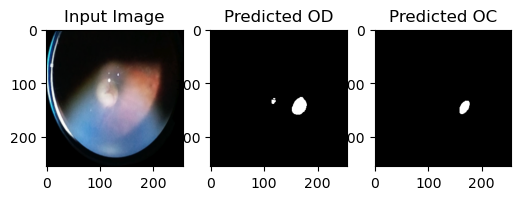

Image index: 57


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


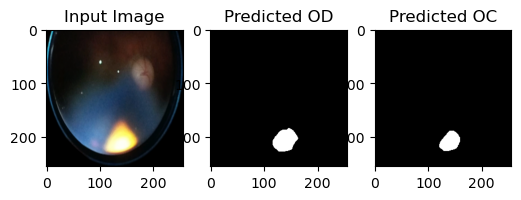

Image index: 58


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


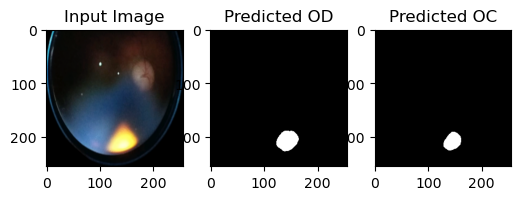

Image index: 59


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


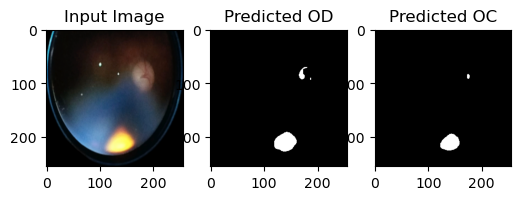

Image index: 60


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


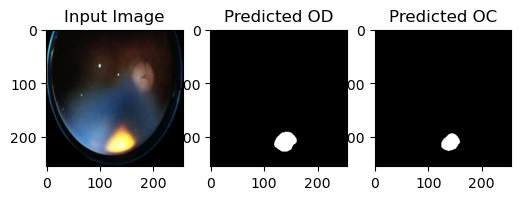

Image index: 61


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


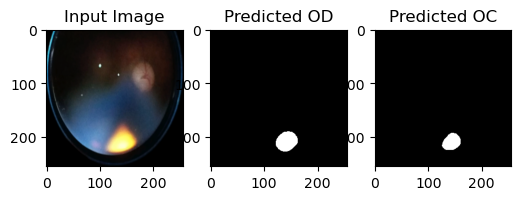

Image index: 62


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


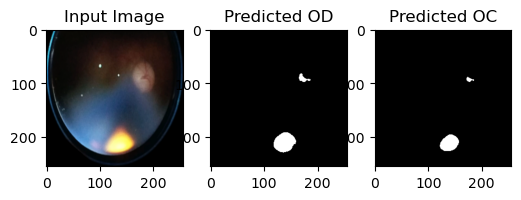

Image index: 63


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


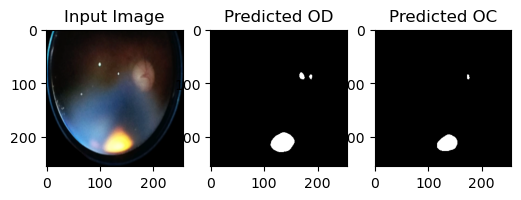

Image index: 64


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


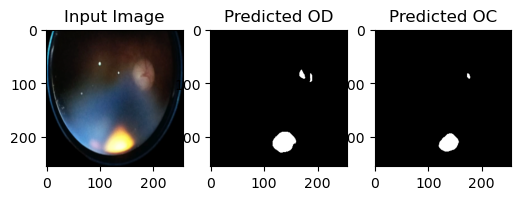

Image index: 65


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


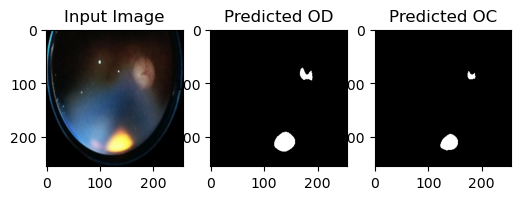

Image index: 66


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


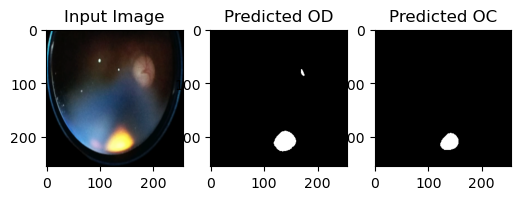

Image index: 67


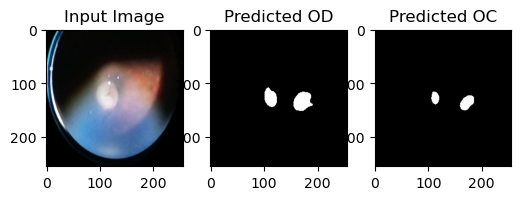

Image index: 68


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


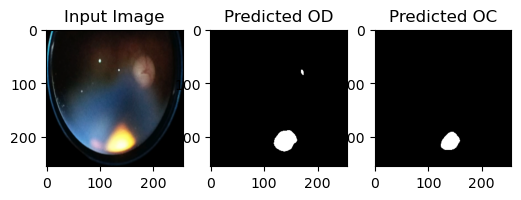

Image index: 69


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


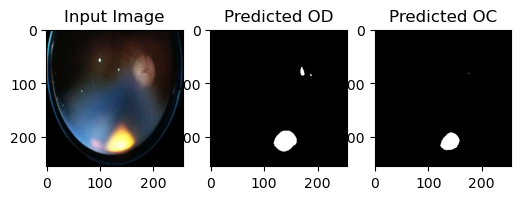

Image index: 70


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


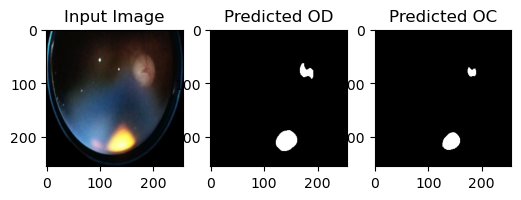

Image index: 71


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


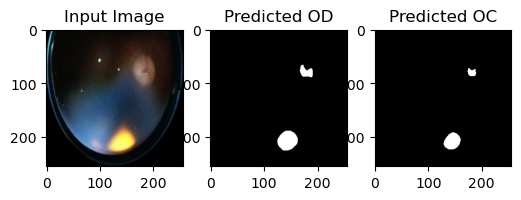

Image index: 72


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


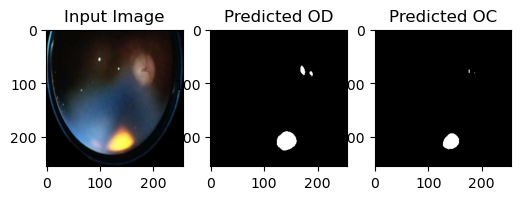

Image index: 73


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


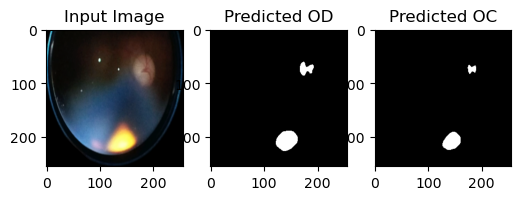

Image index: 74


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


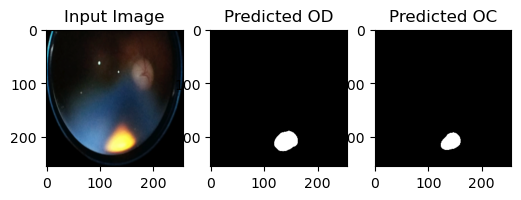

Image index: 75


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


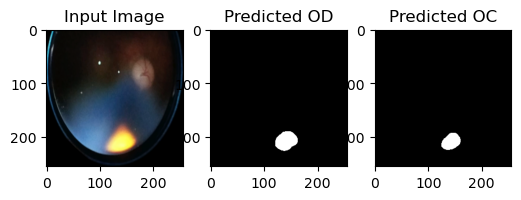

Image index: 76


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


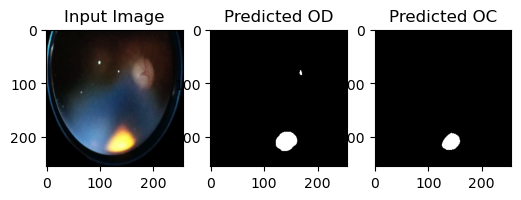

Image index: 77


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


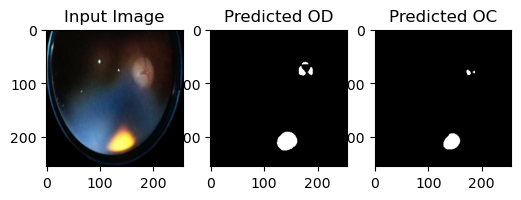

Image index: 78


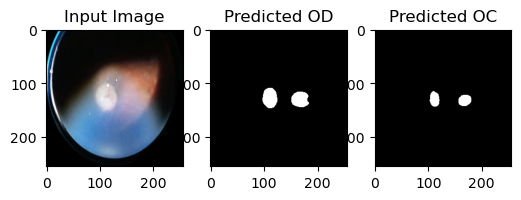

Image index: 79


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


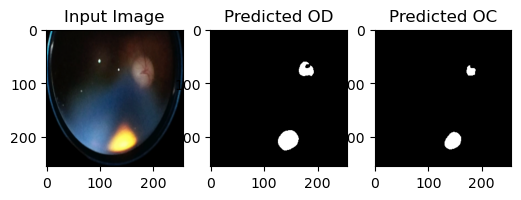

Image index: 80


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


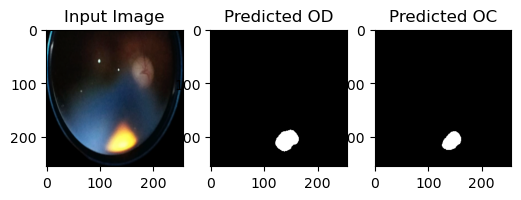

Image index: 81


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


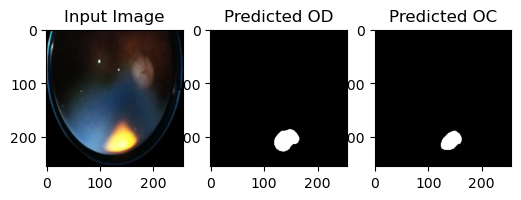

Image index: 82


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


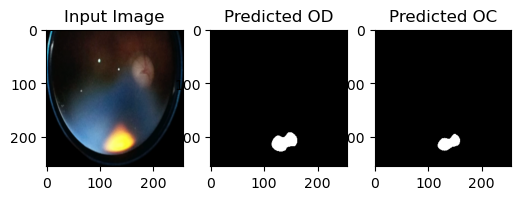

Image index: 83


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


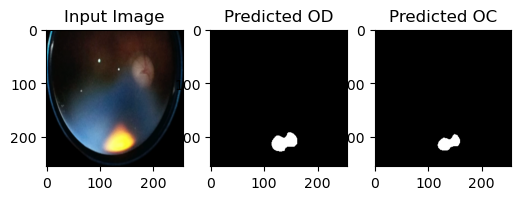

Image index: 84


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


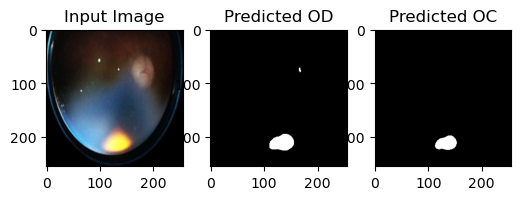

Image index: 85


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


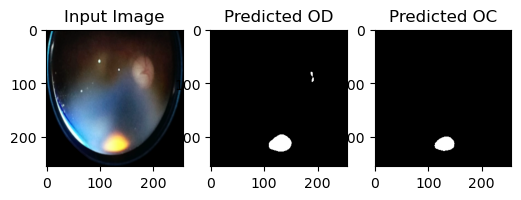

Image index: 86


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


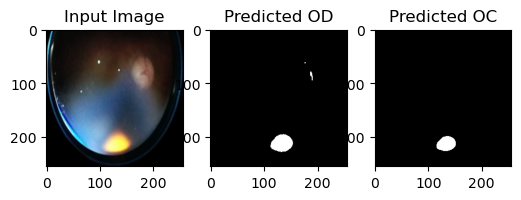

Image index: 87


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


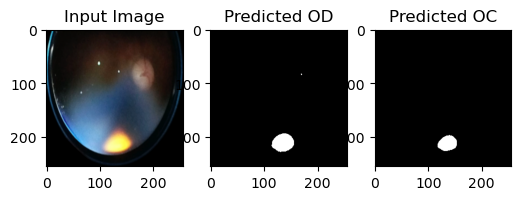

Image index: 88


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


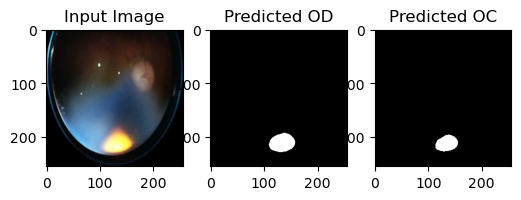

Image index: 89


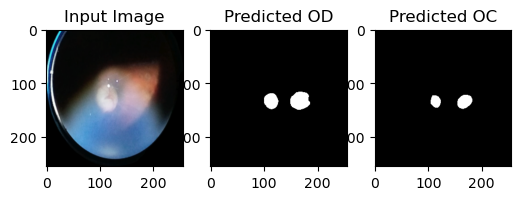

Image index: 90


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


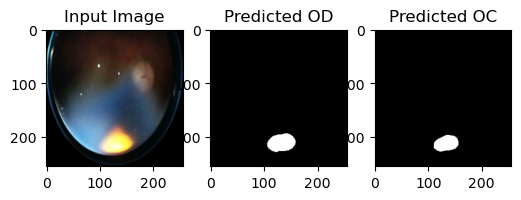

Image index: 91


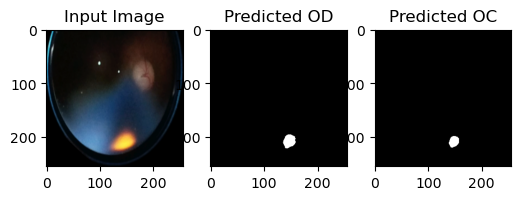

Image index: 92


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


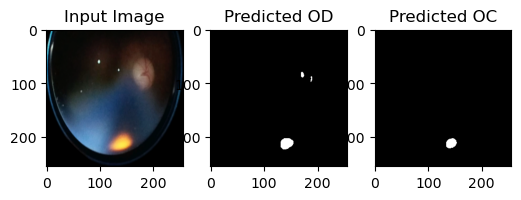

Image index: 93


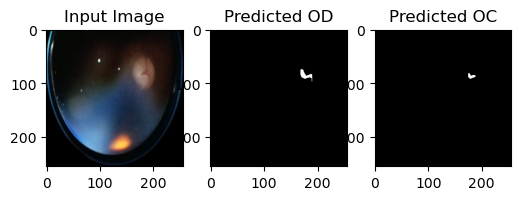

Image index: 94


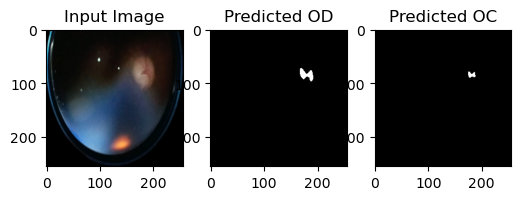

Image index: 95


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


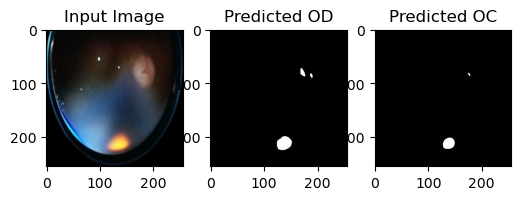

Image index: 96


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


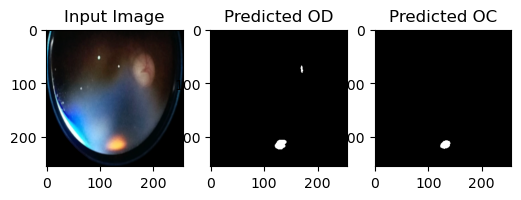

Image index: 97


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


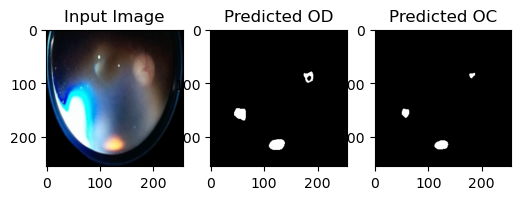

Image index: 98


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


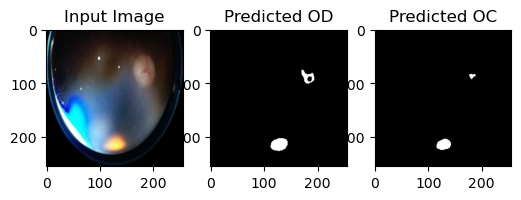

Image index: 99


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


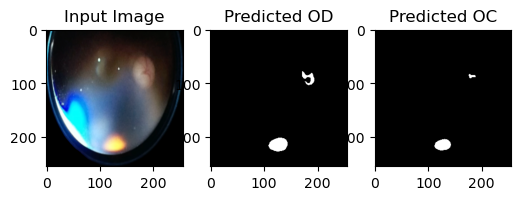

Image index: 100


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


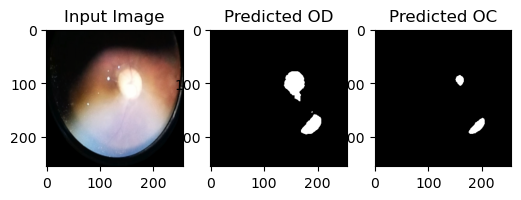

Image index: 101


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


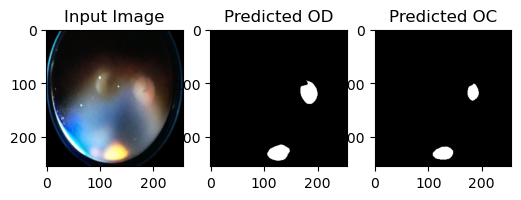

Image index: 102


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


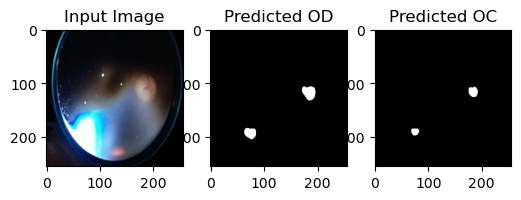

Image index: 103


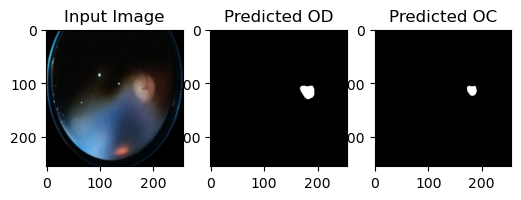

Image index: 104


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


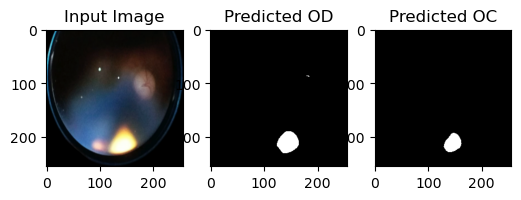

Image index: 105


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


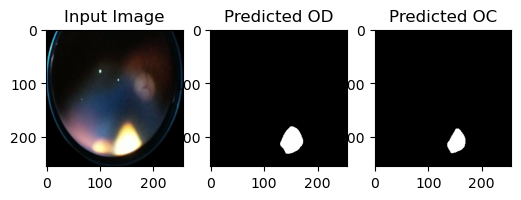

Image index: 106


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


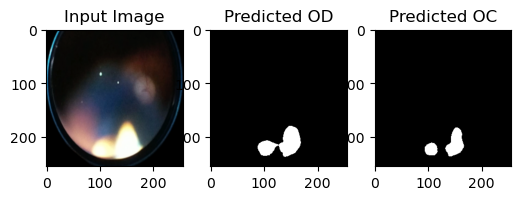

Image index: 107


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


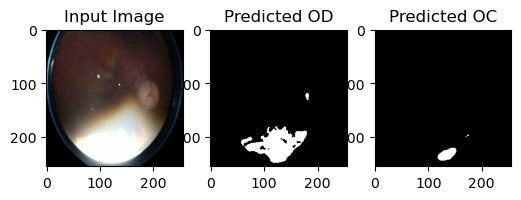

Image index: 108


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


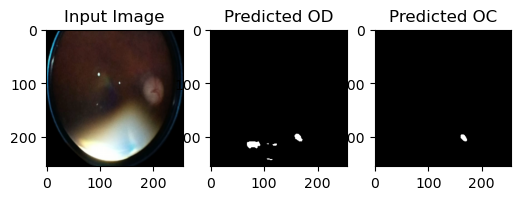

Image index: 109


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


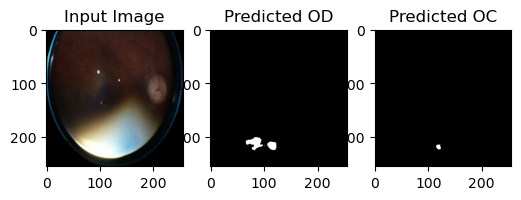

Image index: 110


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


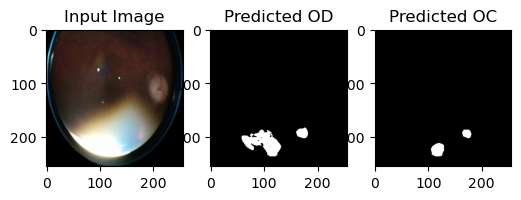

Image index: 111


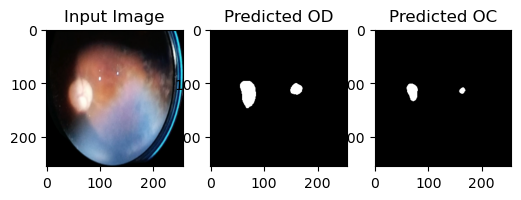

Image index: 112


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


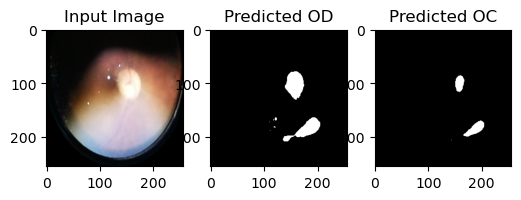

Image index: 113


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


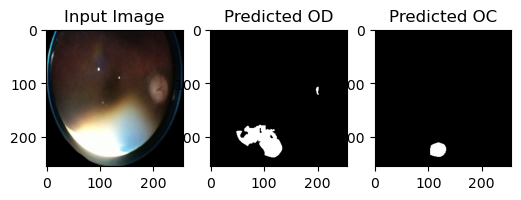

Image index: 114


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


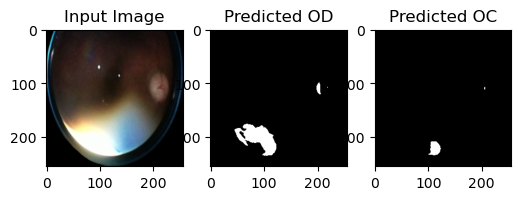

Image index: 115


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


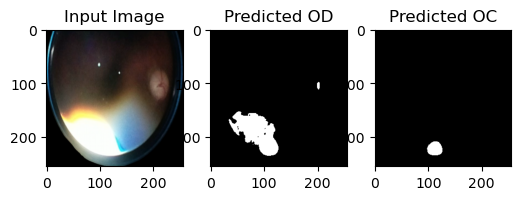

Image index: 116


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


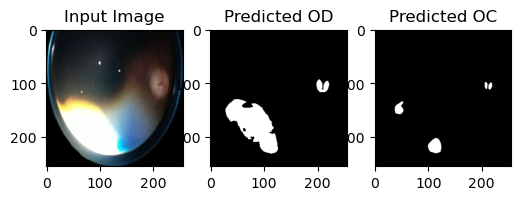

Image index: 117


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


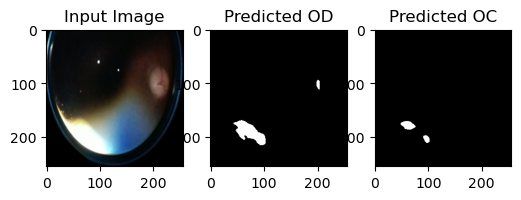

Image index: 118


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


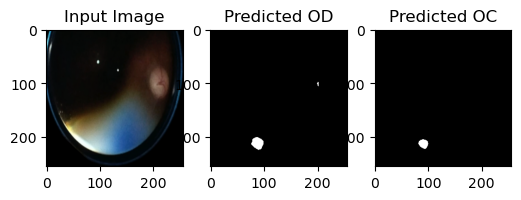

Image index: 119


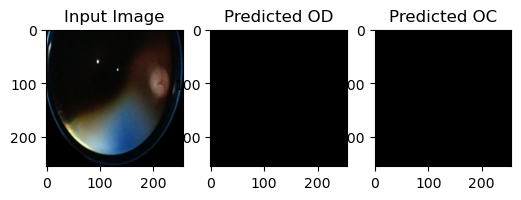

Image index: 120


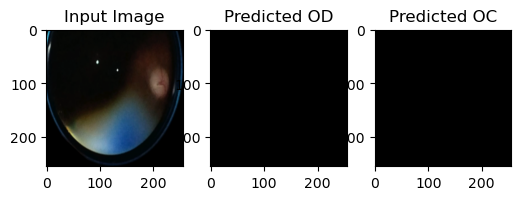

Image index: 121


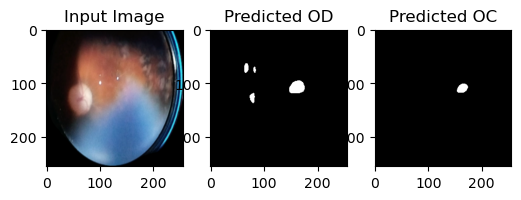

Image index: 122


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


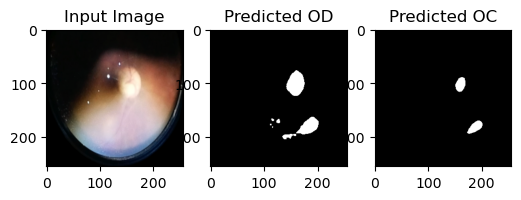

Image index: 123


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


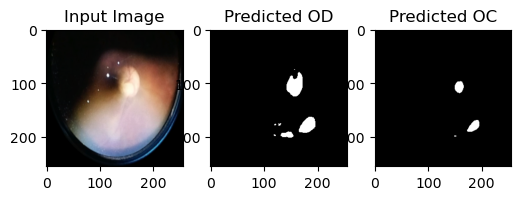

Image index: 124


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


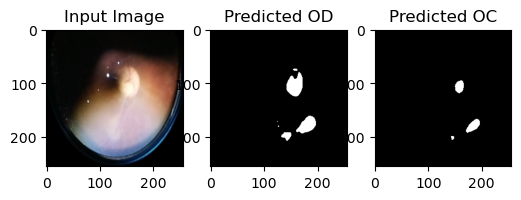

Image index: 125


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


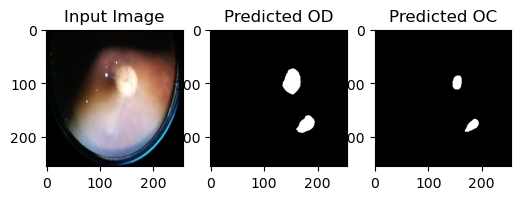

Image index: 126


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


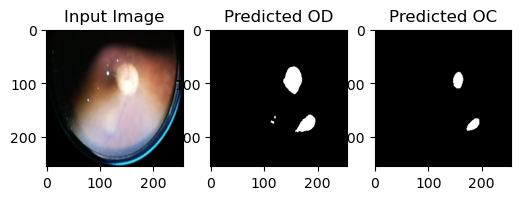

Image index: 127


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


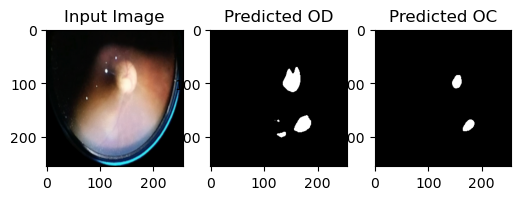

Image index: 128


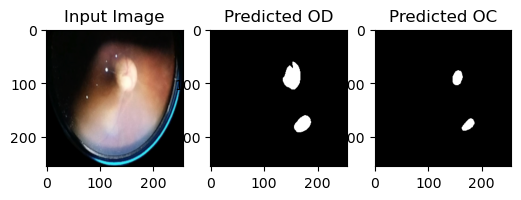

Image index: 129


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


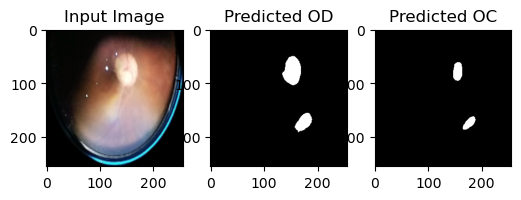

Image index: 130


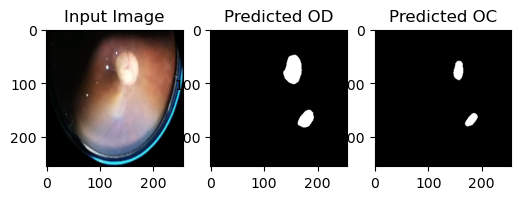

Image index: 131


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


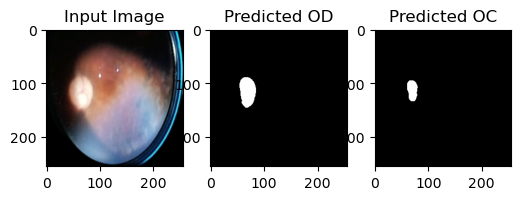

Image index: 132


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


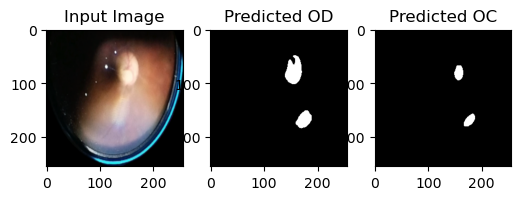

Image index: 133


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


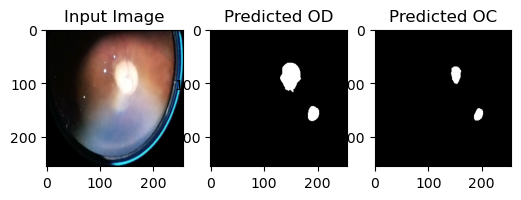

Image index: 134


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


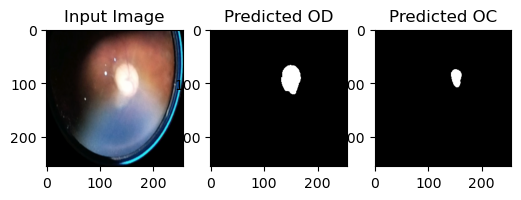

Image index: 135


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


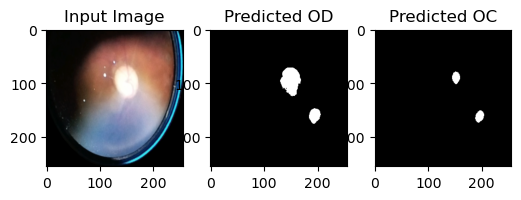

Image index: 136


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


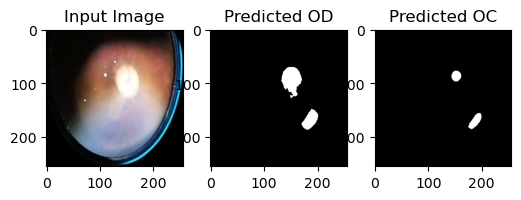

Image index: 137


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


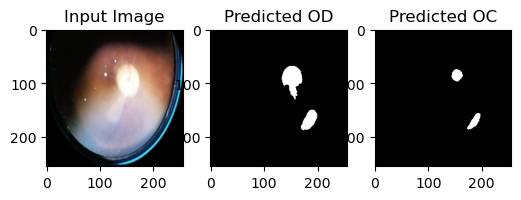

Image index: 138


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


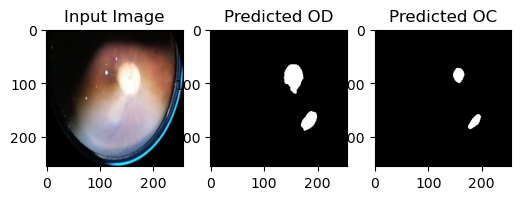

Image index: 139


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


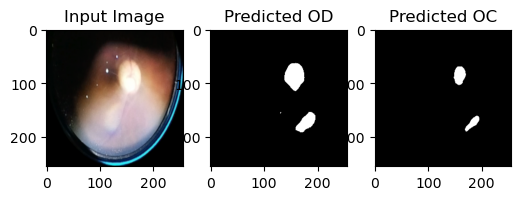

Image index: 140


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


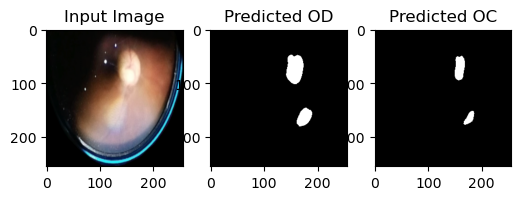

Image index: 141


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


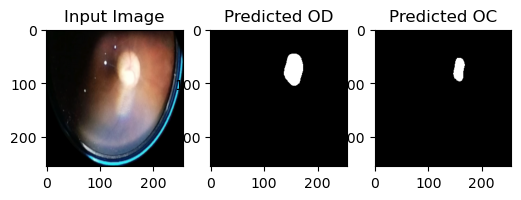

Image index: 142


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


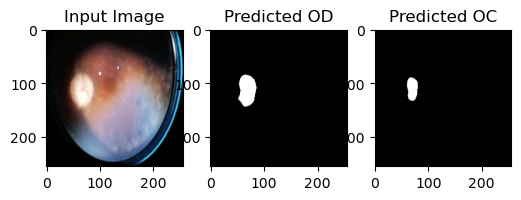

Image index: 143


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


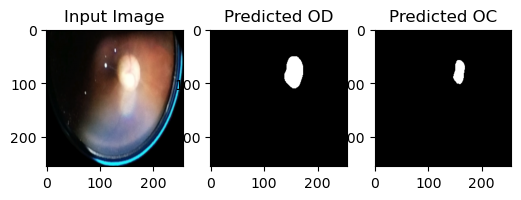

Image index: 144


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


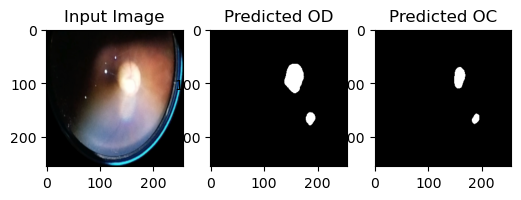

Image index: 145


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


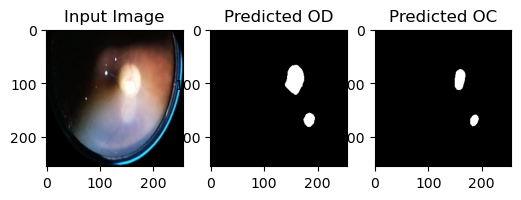

Image index: 146


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


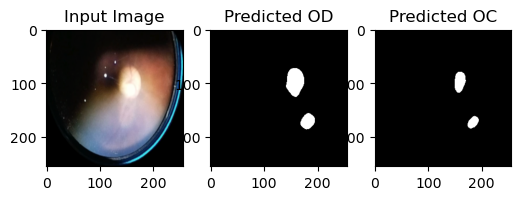

Image index: 147


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


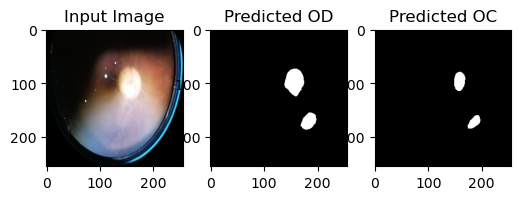

Image index: 148


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


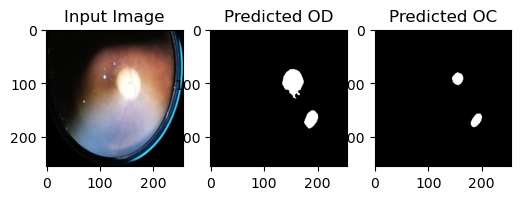

Image index: 149


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


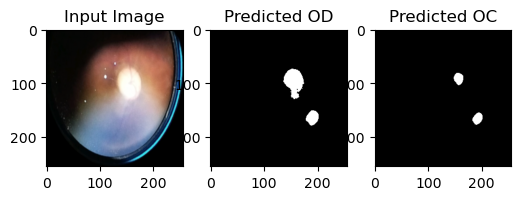

Image index: 150


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


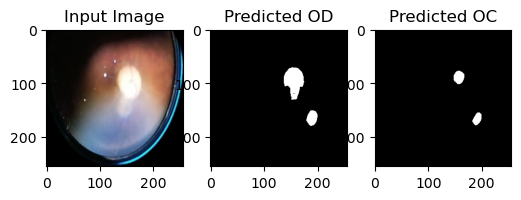

Image index: 151


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


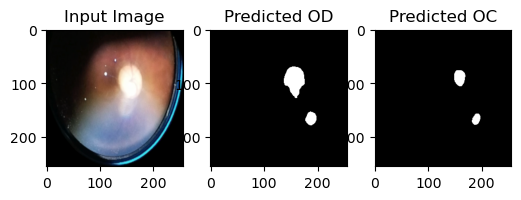

Image index: 152


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


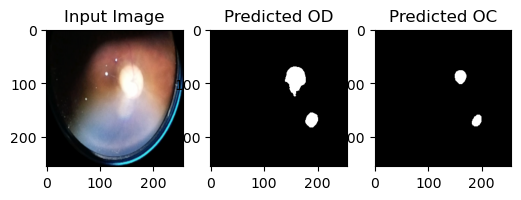

Image index: 153


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


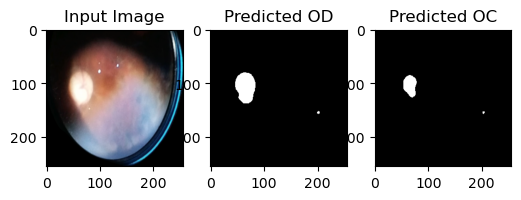

Image index: 154


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


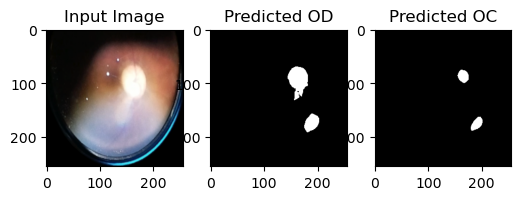

Image index: 155


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


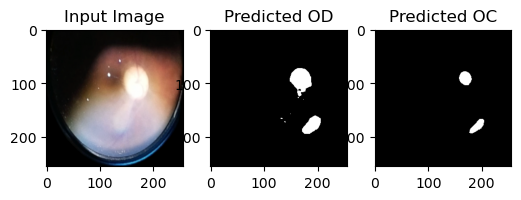

Image index: 156


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


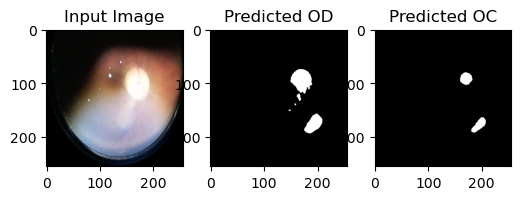

Image index: 157


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


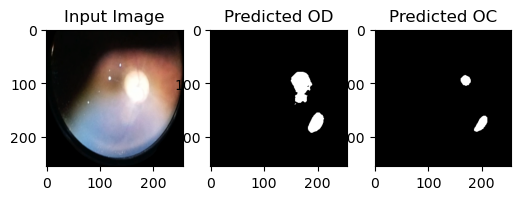

Image index: 158


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


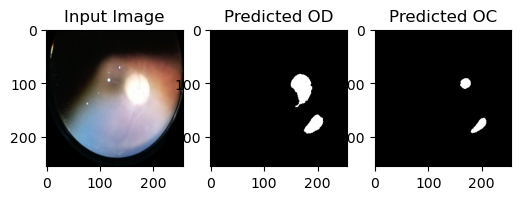

Image index: 159


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


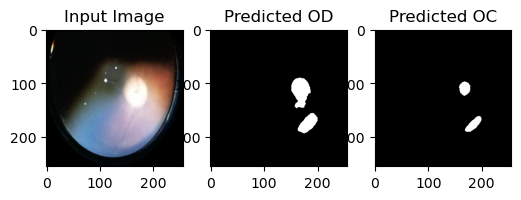

Image index: 160


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


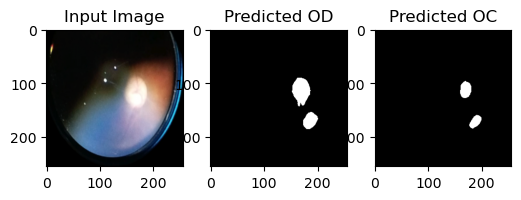

Image index: 161


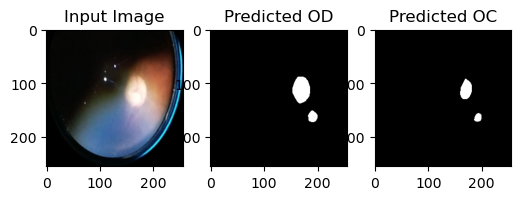

Image index: 162


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


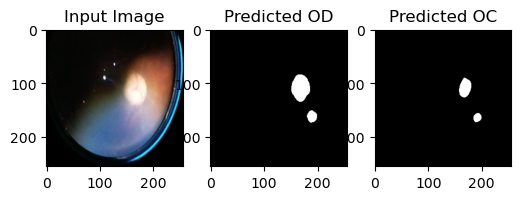

Image index: 163


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


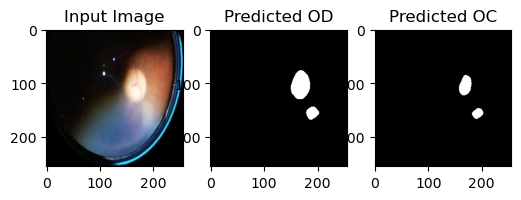

Image index: 164


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


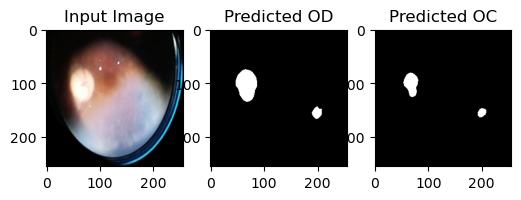

Image index: 165


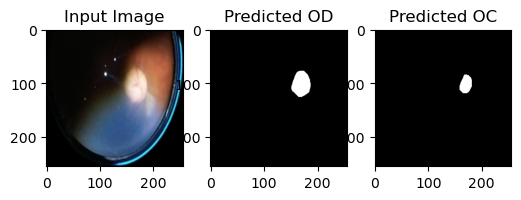

Image index: 166


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


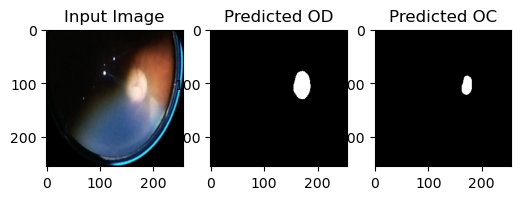

Image index: 167


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


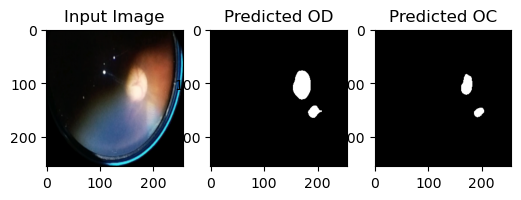

Image index: 168


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


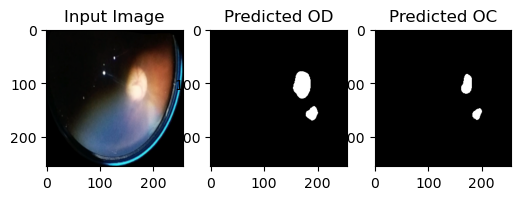

Image index: 169


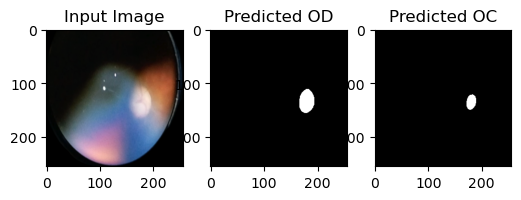

Image index: 170


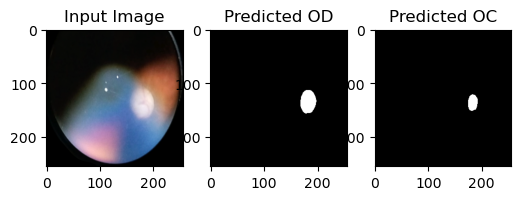

Image index: 171


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


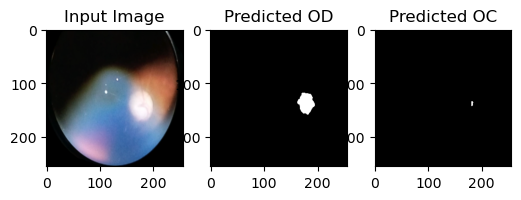

Image index: 172


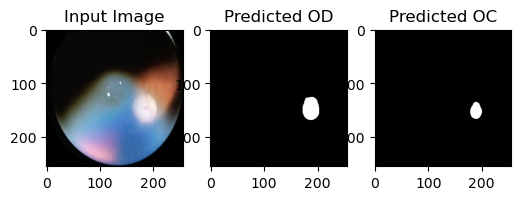

Image index: 173


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


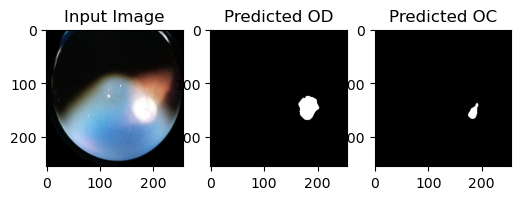

Image index: 174


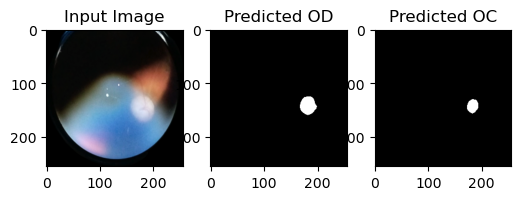

Image index: 175


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


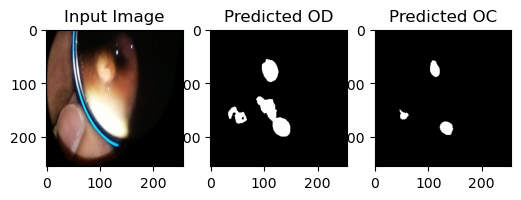

Image index: 176


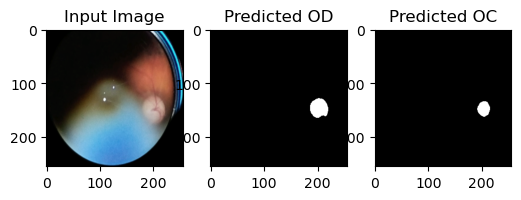

Image index: 177


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


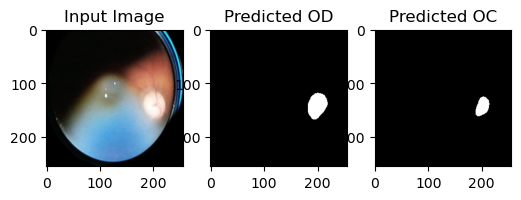

Image index: 178


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


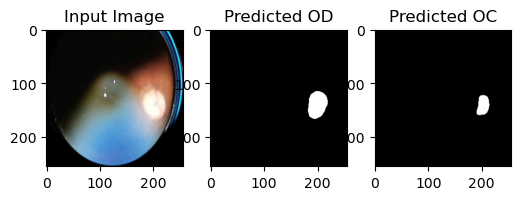

Image index: 179


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


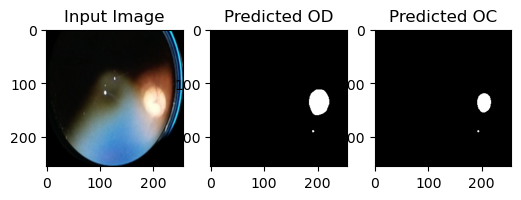

Image index: 180


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


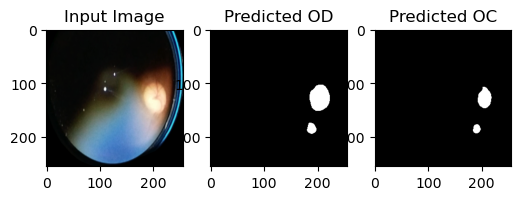

Image index: 181


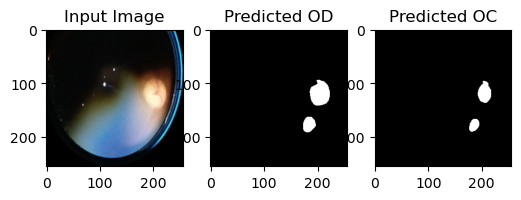

Image index: 182


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


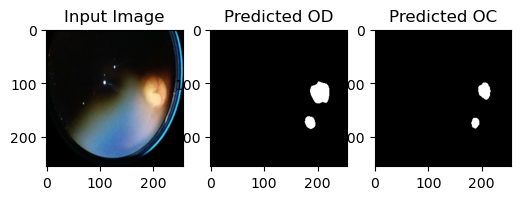

Image index: 183


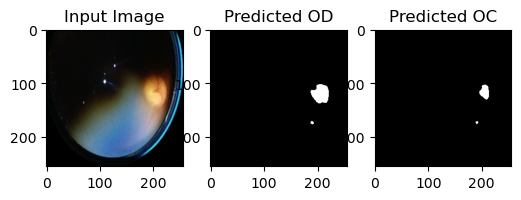

Image index: 184


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


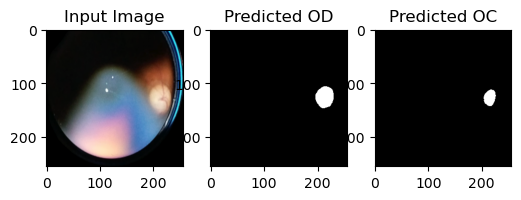

Image index: 185


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


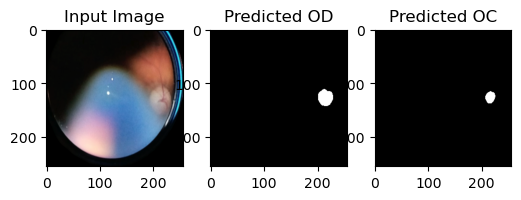

Image index: 186


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


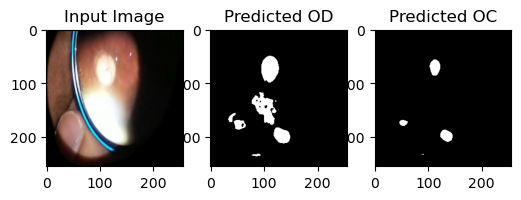

Image index: 187


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


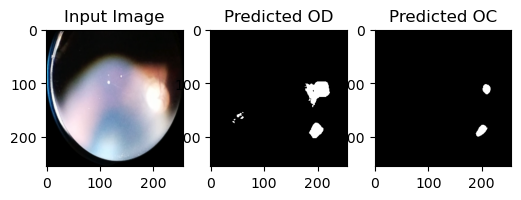

Image index: 188


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


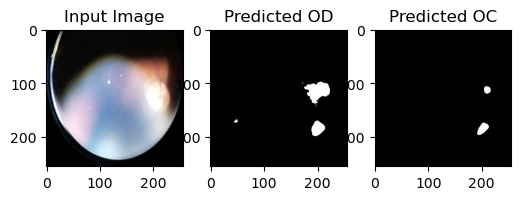

Image index: 189


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


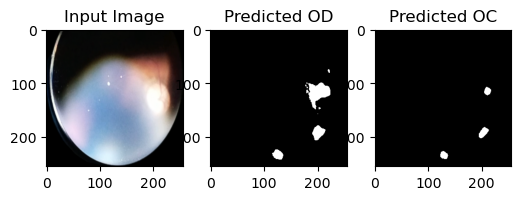

Image index: 190


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


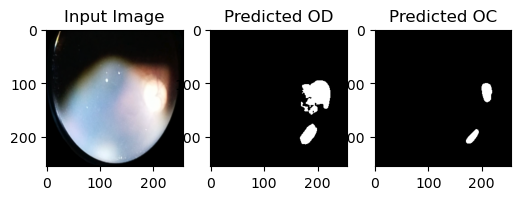

Image index: 191


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


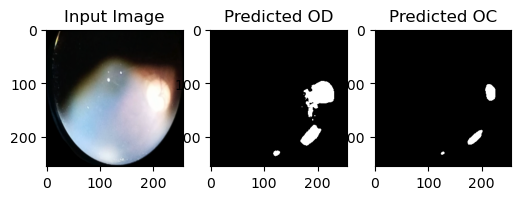

Image index: 192


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


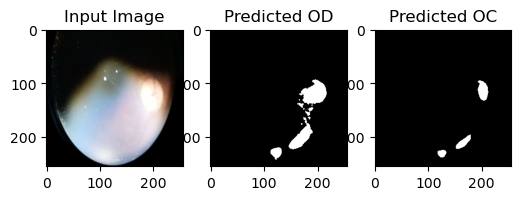

Image index: 193


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


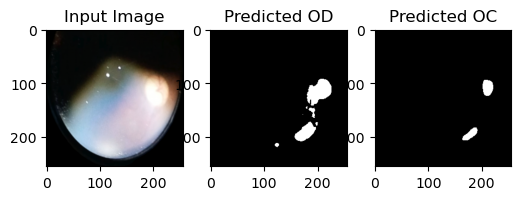

Image index: 194


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


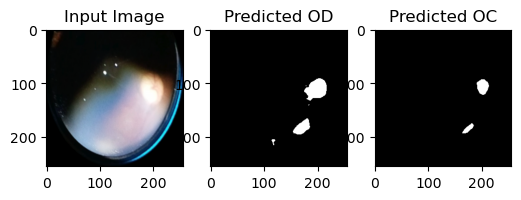

Image index: 195


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


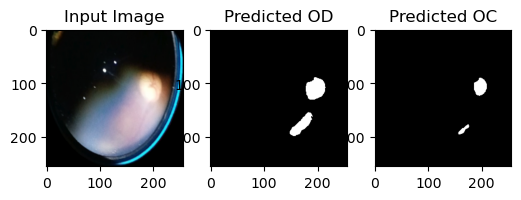

Image index: 196


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


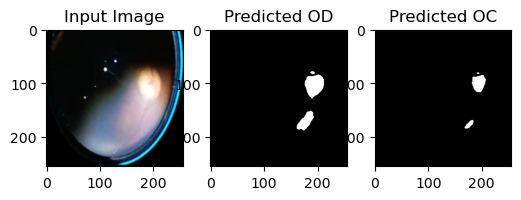

Image index: 197


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


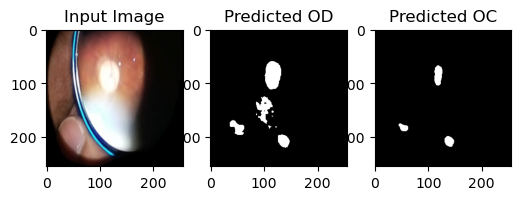

Image index: 198


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


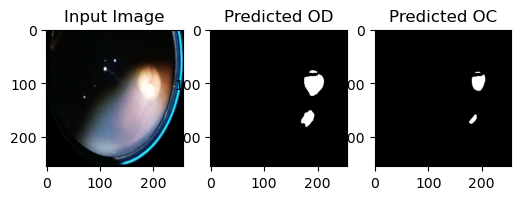

Image index: 199


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


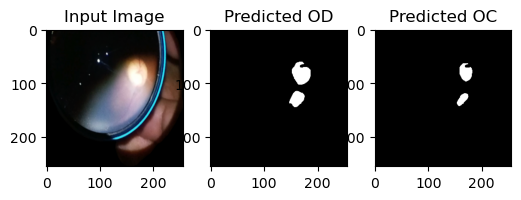

Image index: 200


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


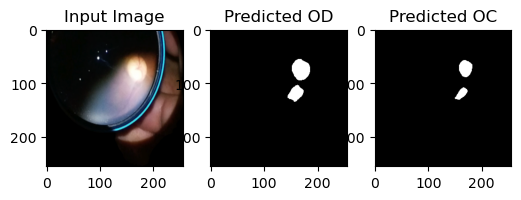

Image index: 201


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


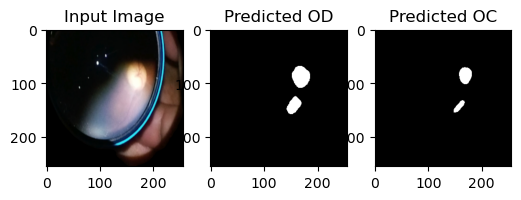

Image index: 202


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


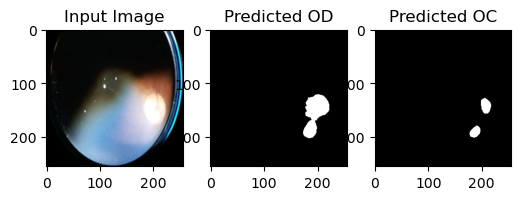

Image index: 203


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


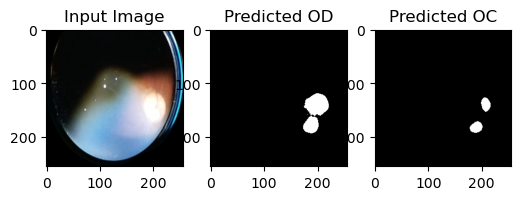

Image index: 204


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


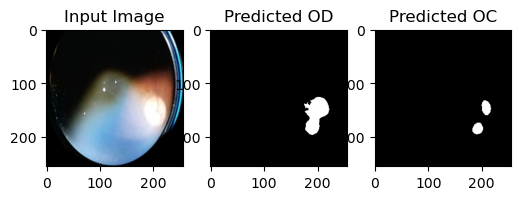

Image index: 205


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


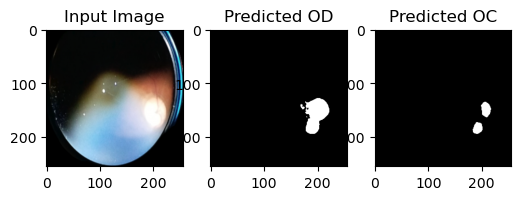

Image index: 206


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


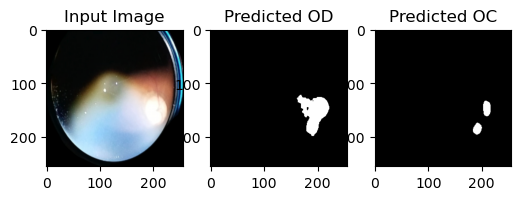

Image index: 207


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


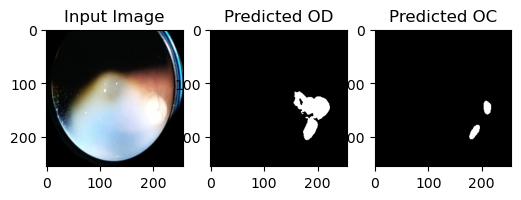

In [10]:
# Look at all predictions for subject 2 

for i, img in enumerate(images_subj2):
    print(f"Image index: {i}")
    pred_od, pred_oc = predict(img, model, device)

Top 3 predictions for subject 2:

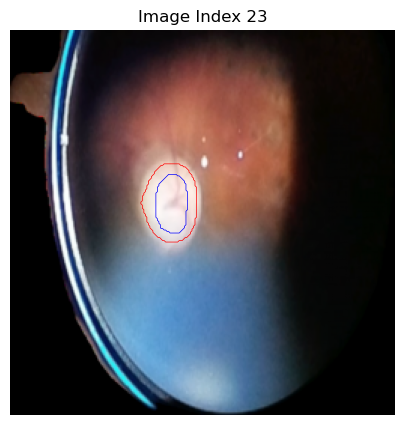

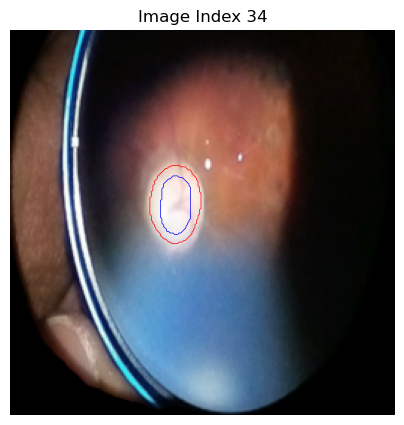

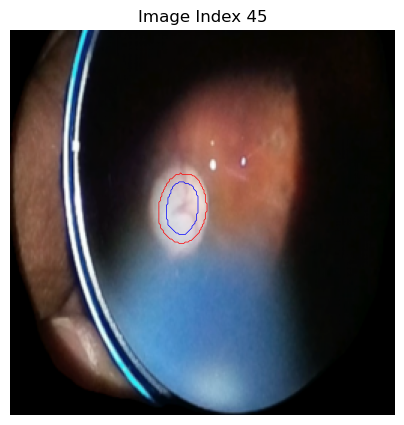

In [21]:
idxs = [23, 34, 45]
for idx in idxs:
    img = images_subj2[idx]
    pred_od, pred_oc = predict(img, model, device, plot=False)
    img = img.squeeze().cpu().numpy().transpose(1,2,0)
    plt.figure(figsize=(5,5))
    plt.imshow(img)
    plt.contour(pred_od, levels=[0.5], colors="red", linewidths=0.5)
    plt.contour(pred_oc, levels=[0.5], colors="blue", linewidths=0.5)
    plt.title(f"Image Index {idx}")
    plt.axis("off")
    plt.show()

## Subject 3

In [23]:
# Read in image files 
clinic_path = os.path.join("..", "data", "Clinic")
subject3_path = os.path.join(clinic_path, "Subject-3")

subj3_filenames = sorted(os.listdir(subject3_path))

# Pre-processing 
images_subj3 = []
for img in subj3_filenames:
    img_name = os.path.join(subject3_path, img)
    img = np.array(Image.open(img_name).convert('RGB')) 
    img = transforms.functional.to_tensor(img)
    img = transforms.functional.resize(img, size=(256,256), interpolation=Image.BILINEAR)
    images_subj3.append(img)

Image index: 0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


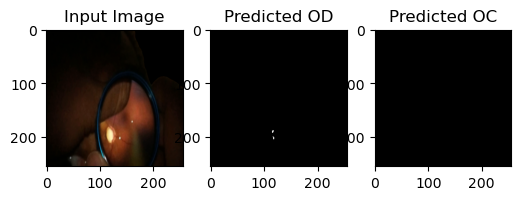

Image index: 1


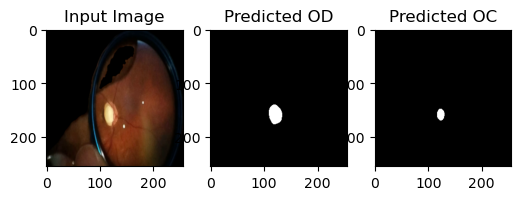

Image index: 2


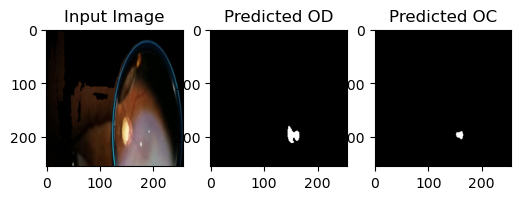

Image index: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


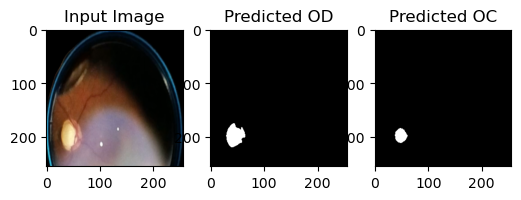

Image index: 4


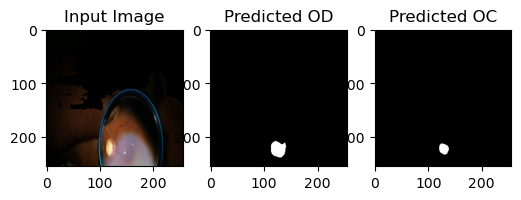

Image index: 5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


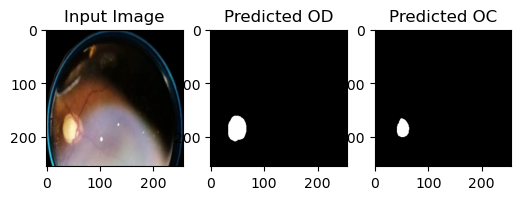

Image index: 6


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


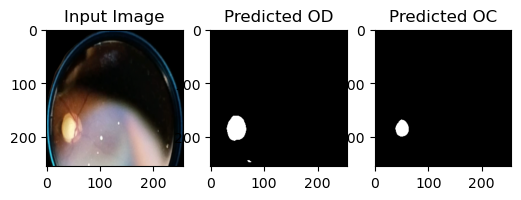

Image index: 7


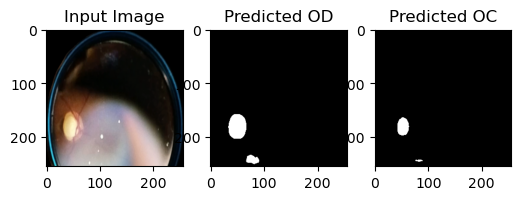

Image index: 8


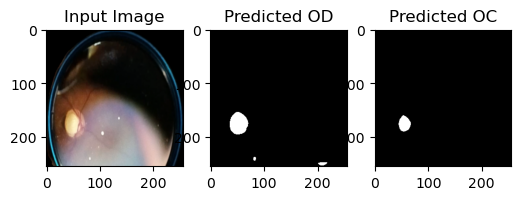

Image index: 9


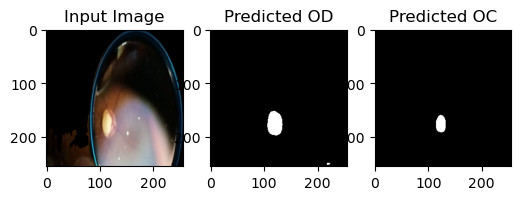

Image index: 10


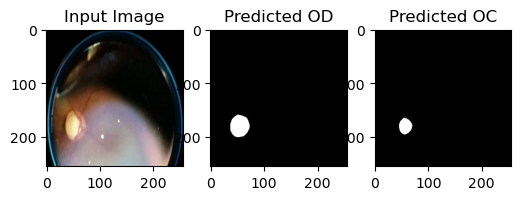

Image index: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


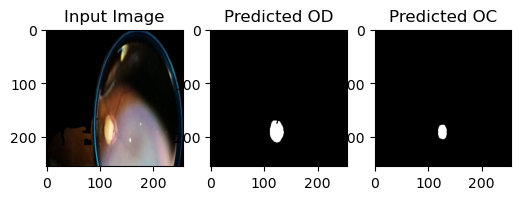

Image index: 12


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


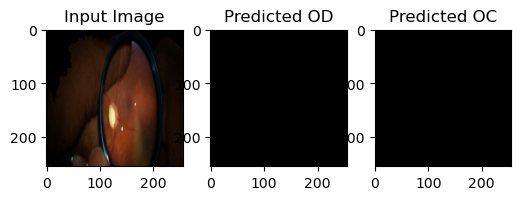

Image index: 13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


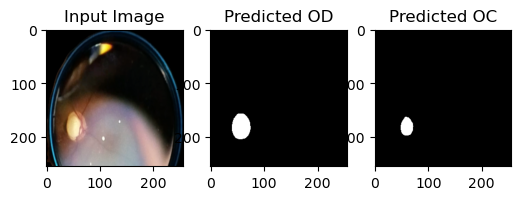

Image index: 14


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


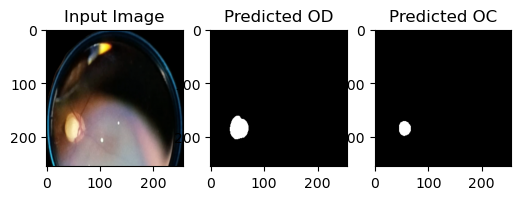

Image index: 15


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


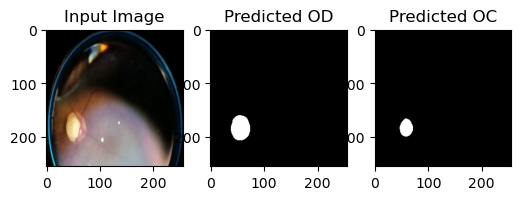

Image index: 16


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


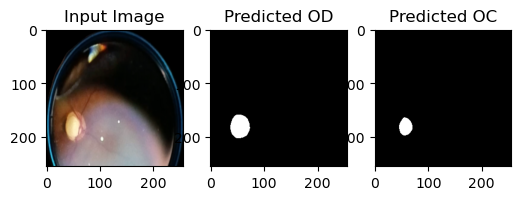

Image index: 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


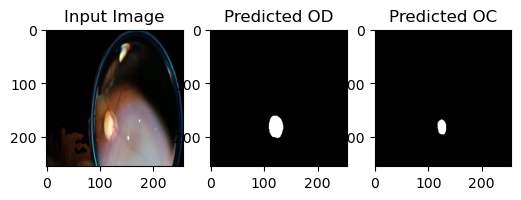

Image index: 18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


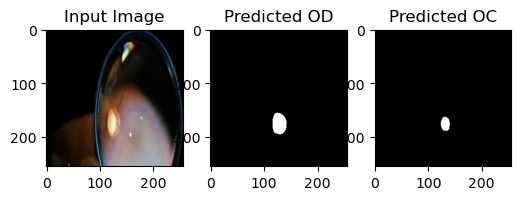

Image index: 19


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


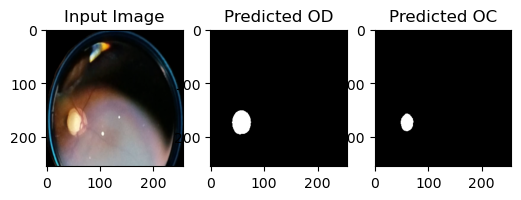

Image index: 20


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


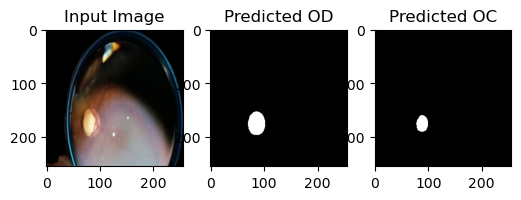

Image index: 21


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


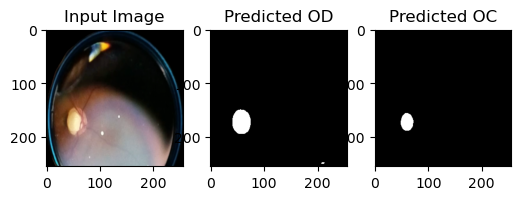

Image index: 22


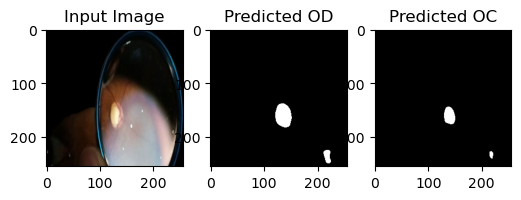

Image index: 23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


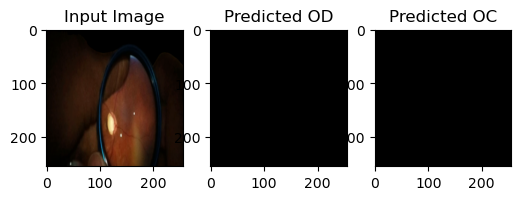

Image index: 24


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


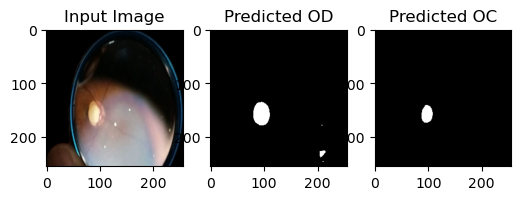

Image index: 25


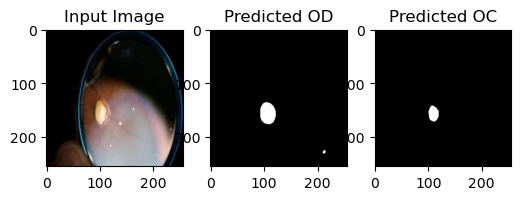

Image index: 26


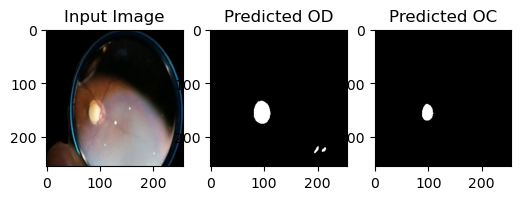

Image index: 27


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


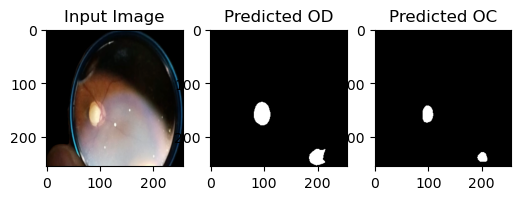

Image index: 28


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


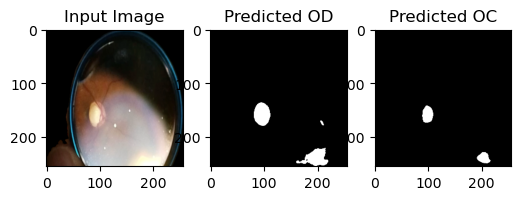

Image index: 29


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


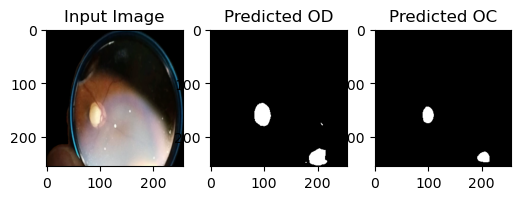

Image index: 30


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


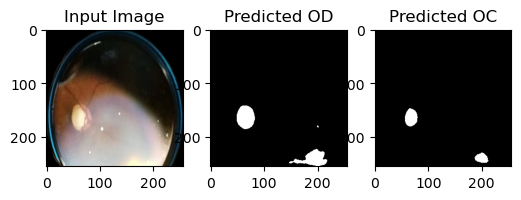

Image index: 31


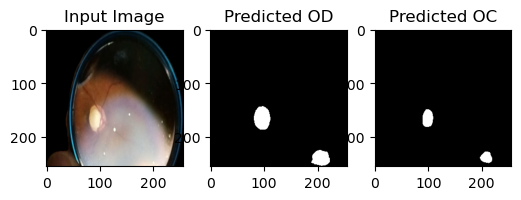

Image index: 32


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


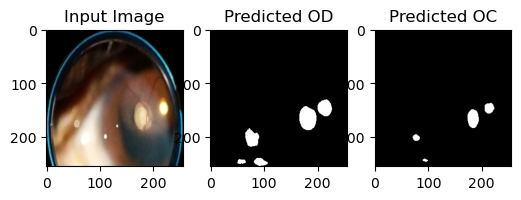

Image index: 33


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


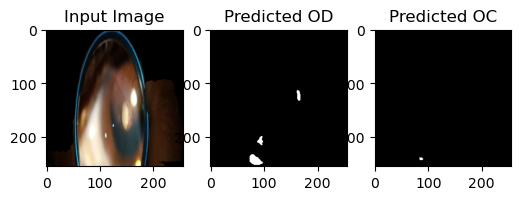

Image index: 34


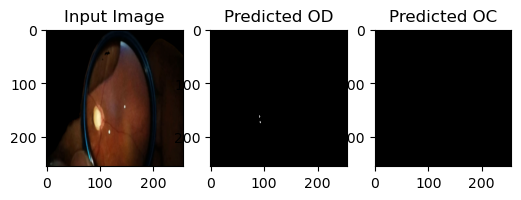

Image index: 35


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


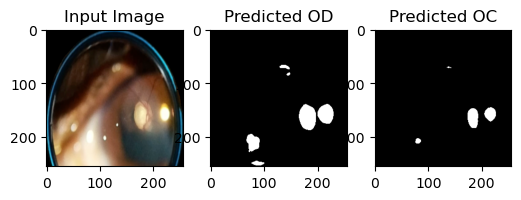

Image index: 36


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


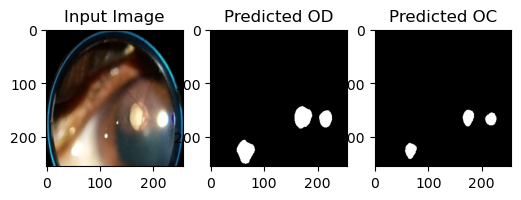

Image index: 37


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


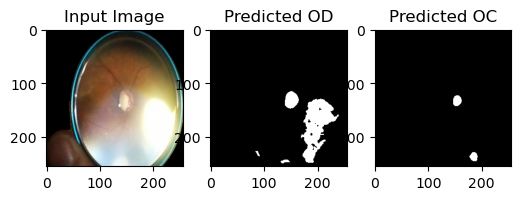

Image index: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


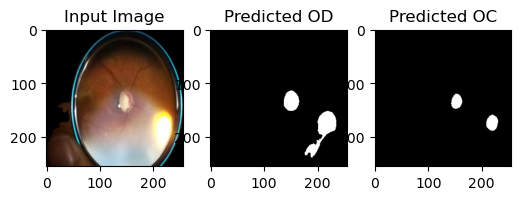

Image index: 39


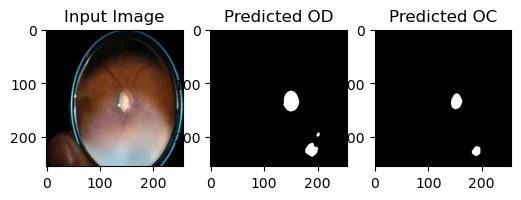

Image index: 40


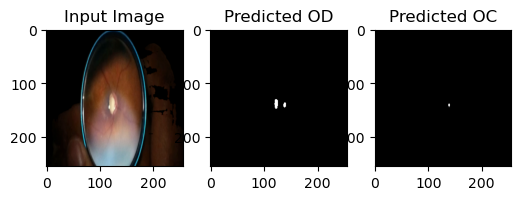

Image index: 41


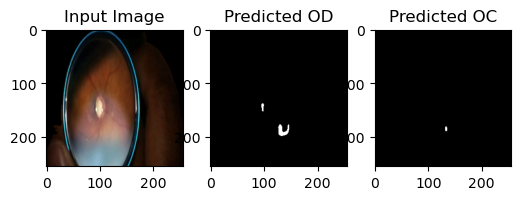

Image index: 42


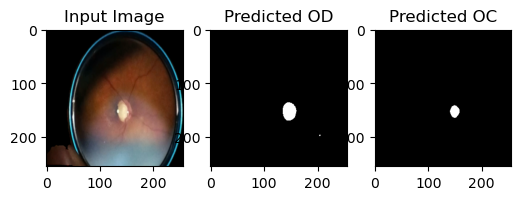

Image index: 43


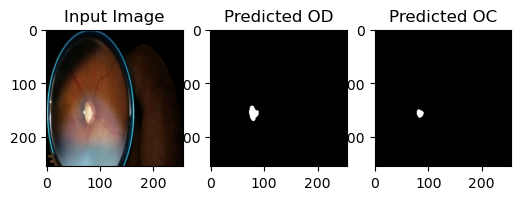

Image index: 44


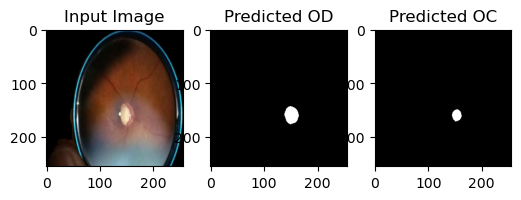

Image index: 45


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


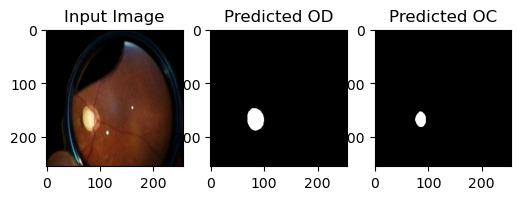

Image index: 46


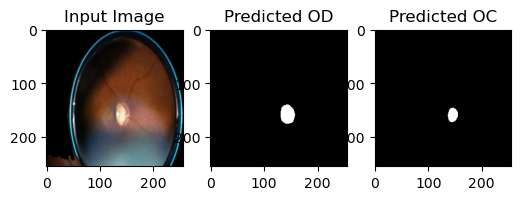

Image index: 47


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


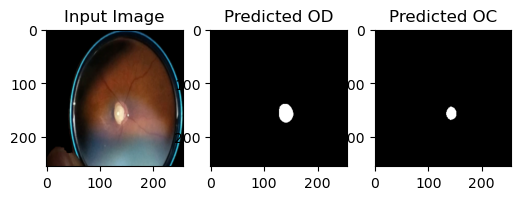

Image index: 48


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


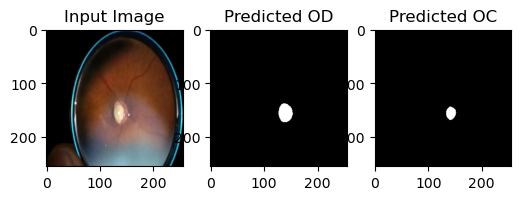

Image index: 49


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


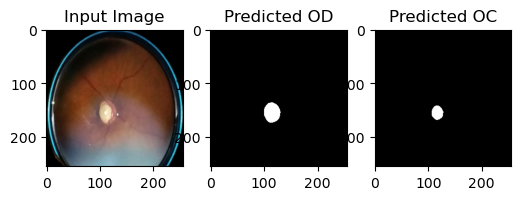

Image index: 50


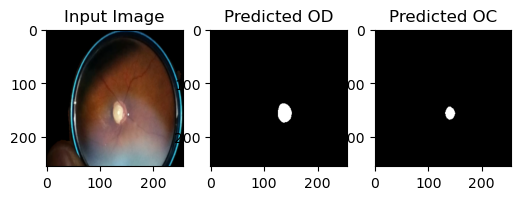

Image index: 51


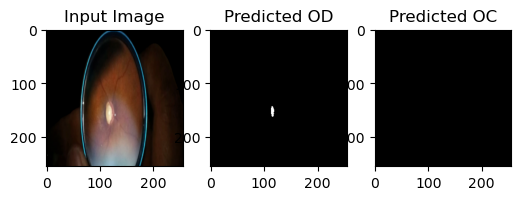

Image index: 52


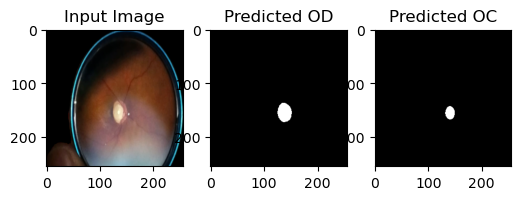

Image index: 53


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


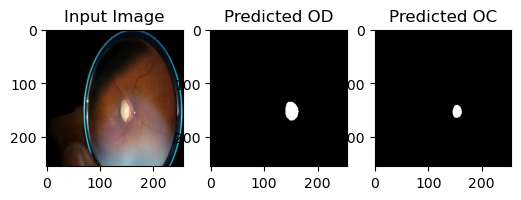

Image index: 54


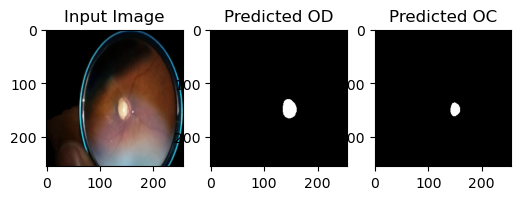

Image index: 55


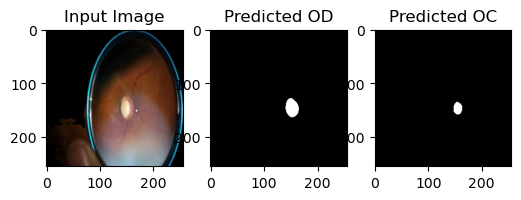

Image index: 56


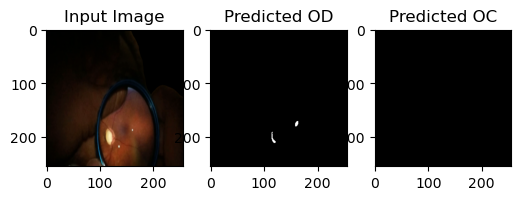

Image index: 57


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


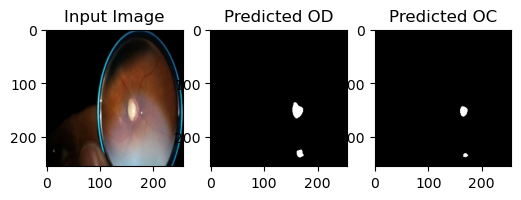

Image index: 58


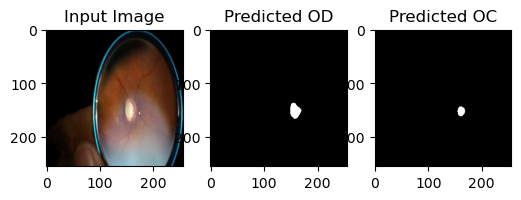

Image index: 59


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


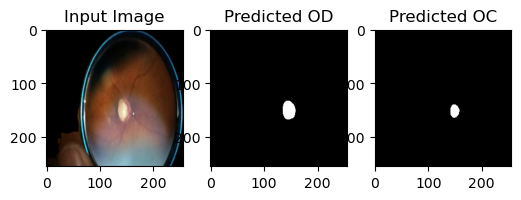

Image index: 60


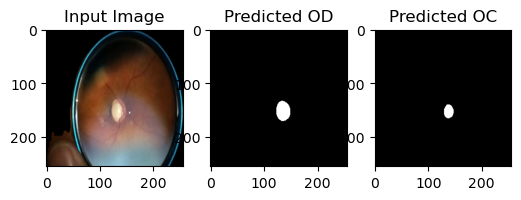

Image index: 61


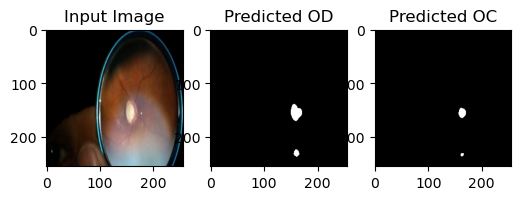

Image index: 62


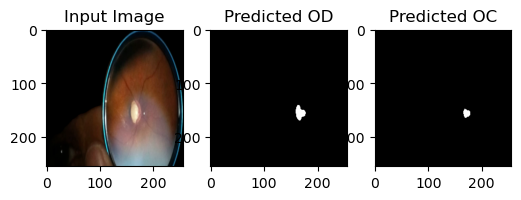

Image index: 63


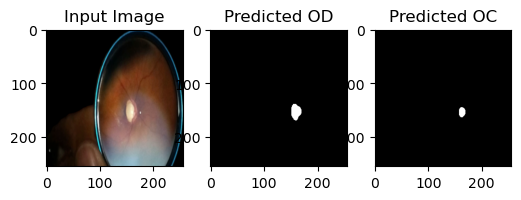

Image index: 64


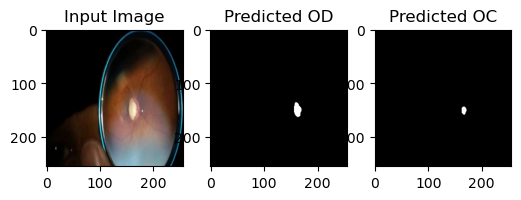

Image index: 65


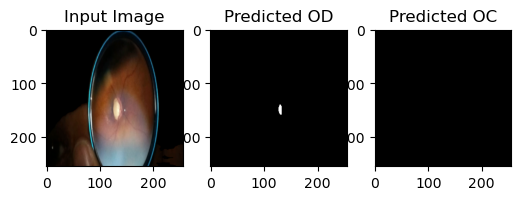

Image index: 66


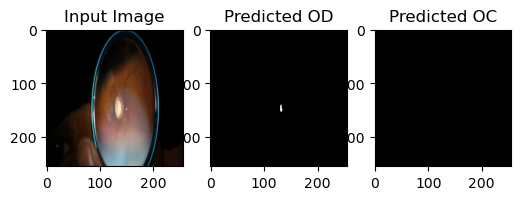

Image index: 67


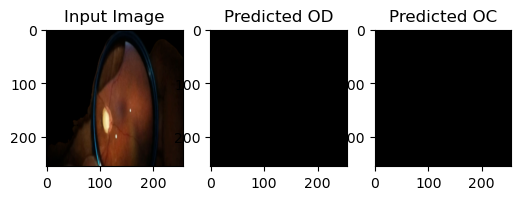

Image index: 68


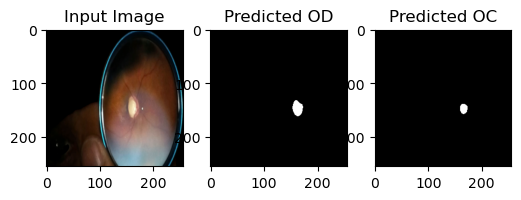

Image index: 69


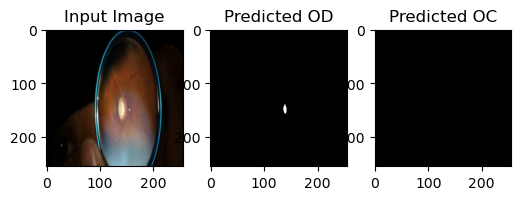

Image index: 70


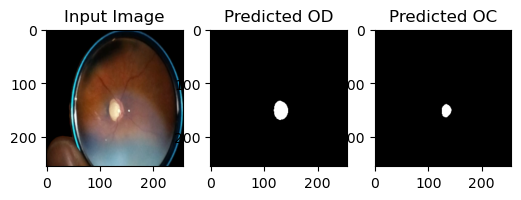

Image index: 71


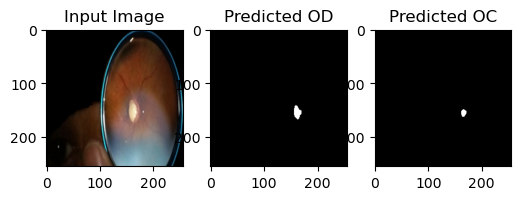

Image index: 72


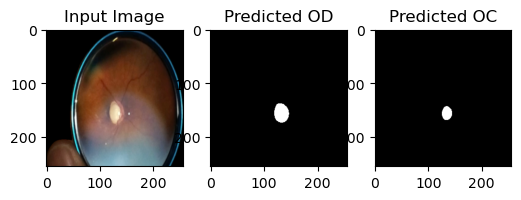

Image index: 73


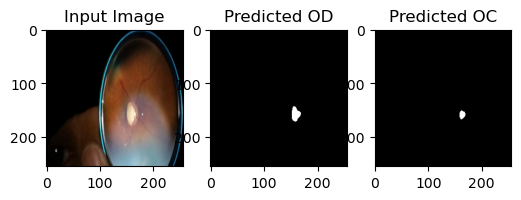

Image index: 74


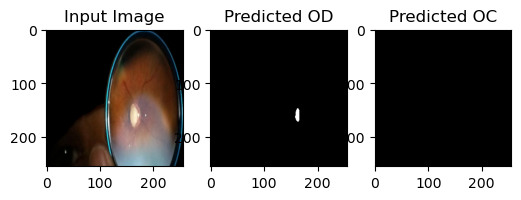

Image index: 75


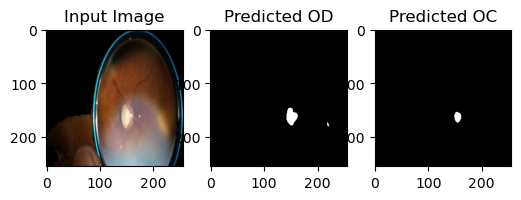

Image index: 76


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


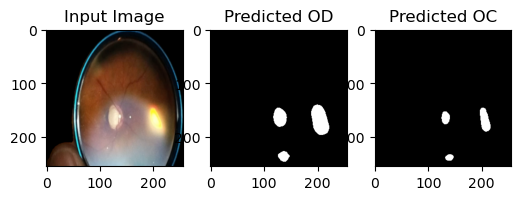

Image index: 77


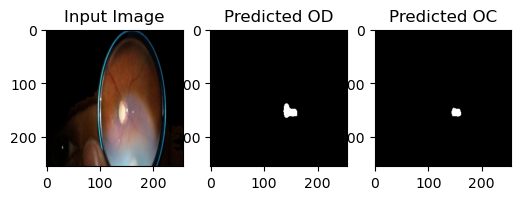

Image index: 78


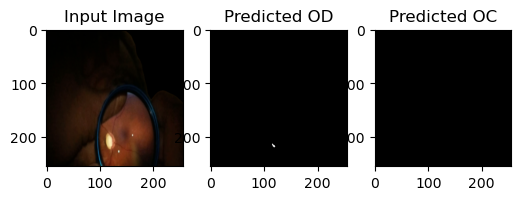

Image index: 79


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


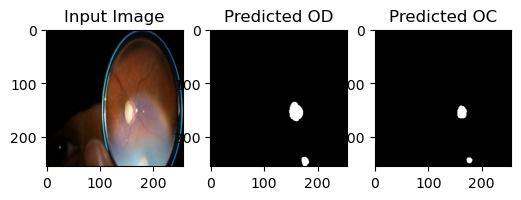

Image index: 80


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


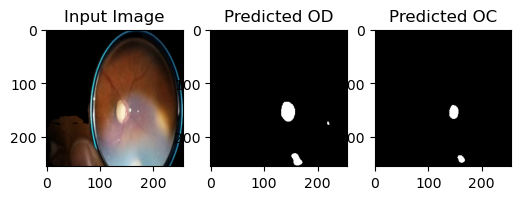

Image index: 81


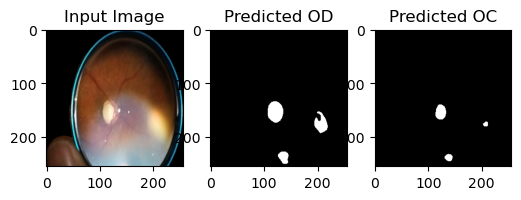

Image index: 82


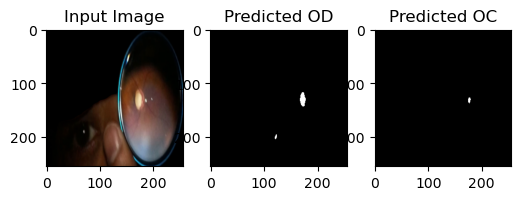

Image index: 83


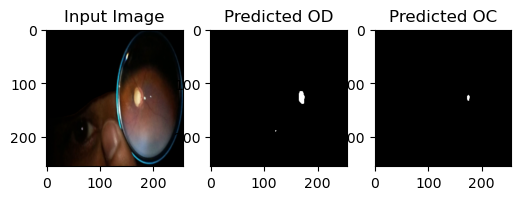

Image index: 84


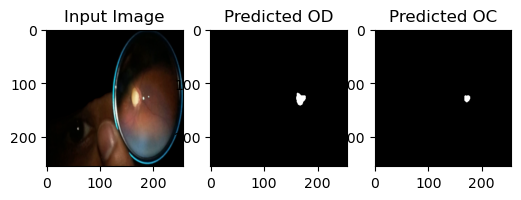

Image index: 85


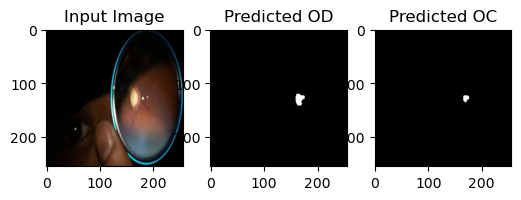

Image index: 86


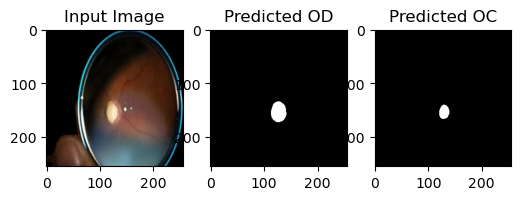

Image index: 87


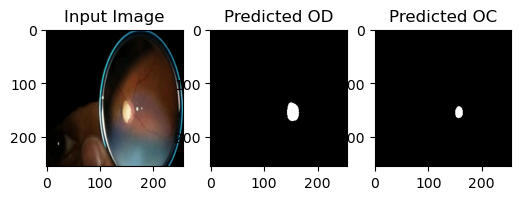

Image index: 88


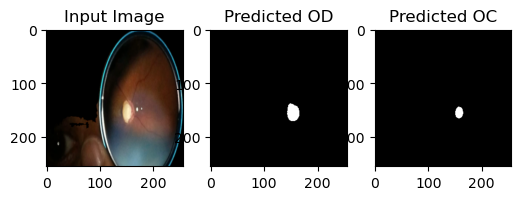

Image index: 89


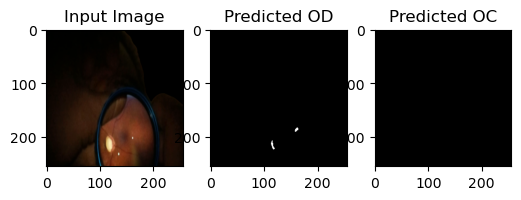

Image index: 90


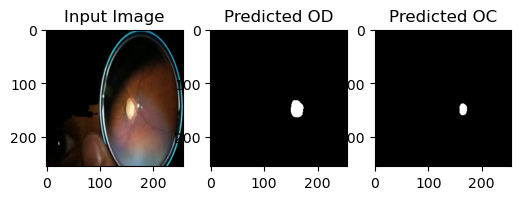

Image index: 91


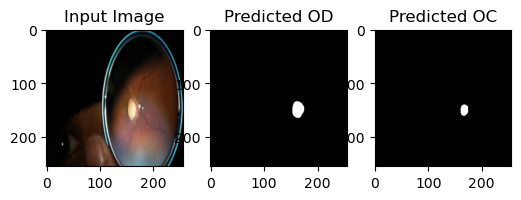

Image index: 92


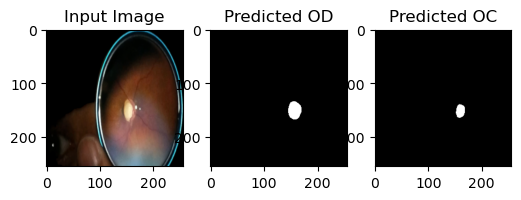

Image index: 93


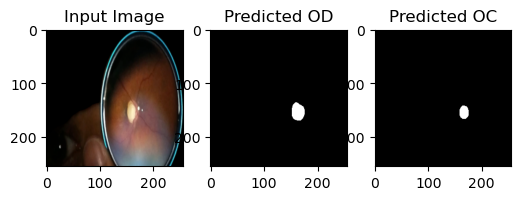

Image index: 94


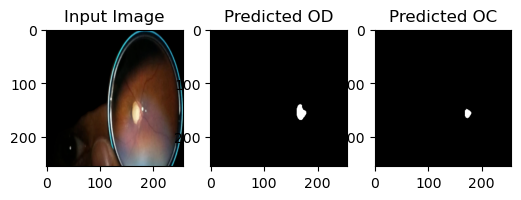

Image index: 95


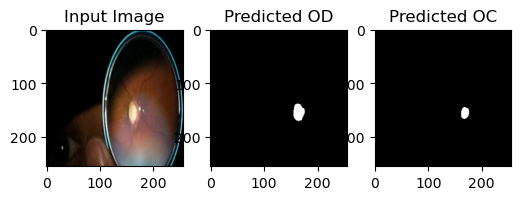

Image index: 96


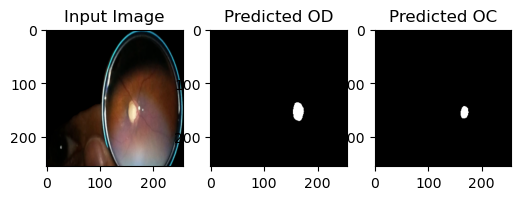

Image index: 97


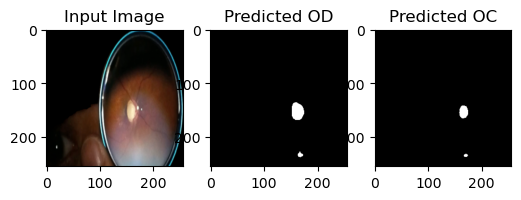

Image index: 98


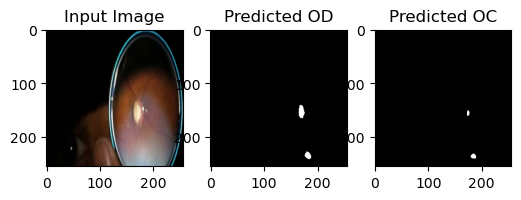

Image index: 99


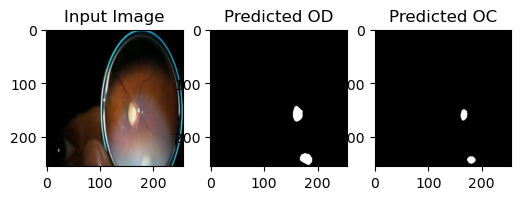

Image index: 100


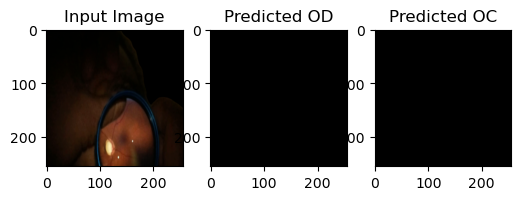

Image index: 101


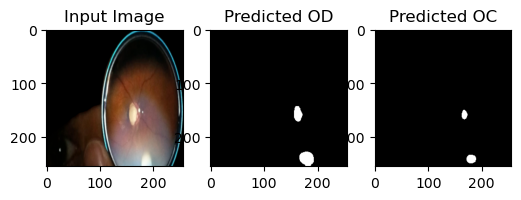

Image index: 102


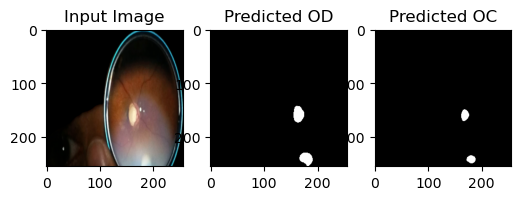

Image index: 103


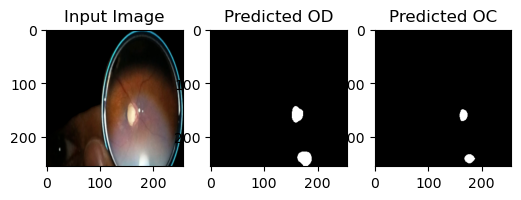

Image index: 104


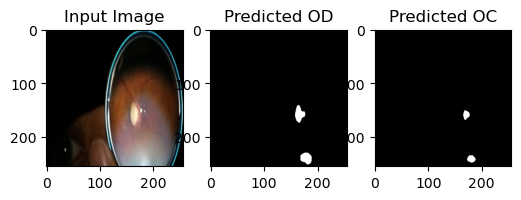

Image index: 105


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


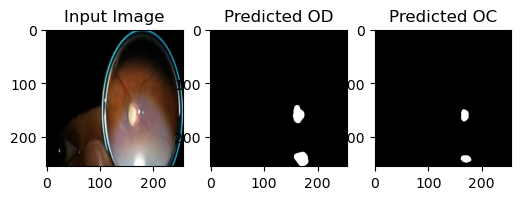

Image index: 106


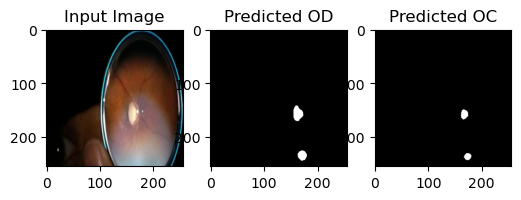

Image index: 107


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


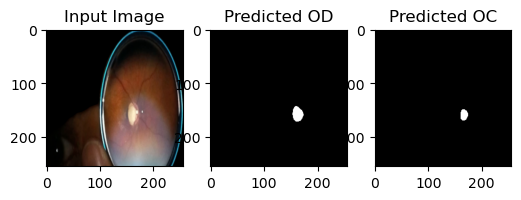

Image index: 108


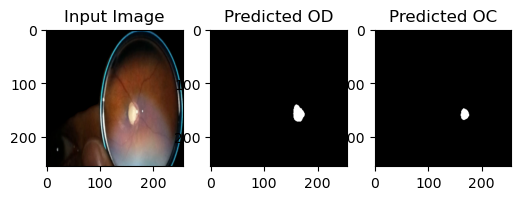

Image index: 109


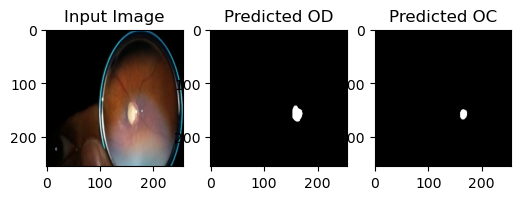

Image index: 110


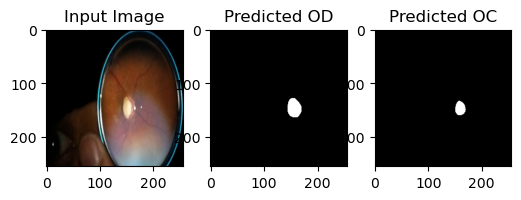

Image index: 111


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


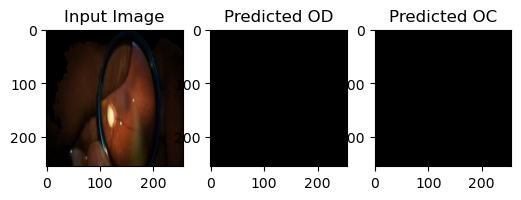

Image index: 112


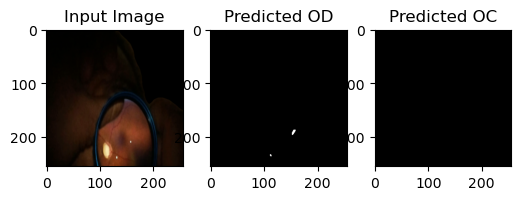

Image index: 113


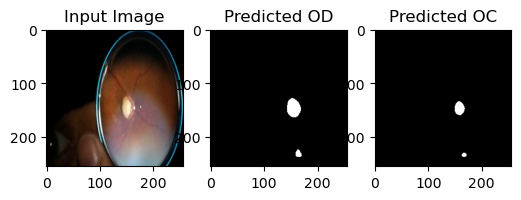

Image index: 114


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


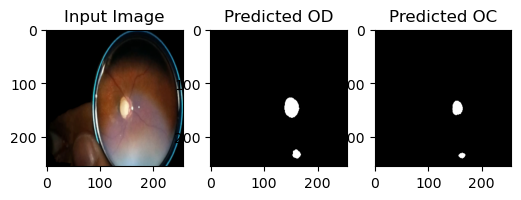

Image index: 115


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


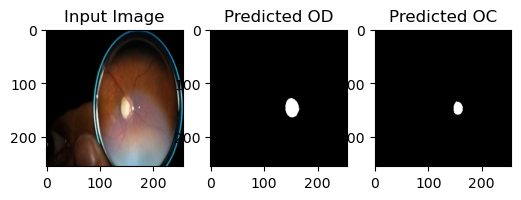

Image index: 116


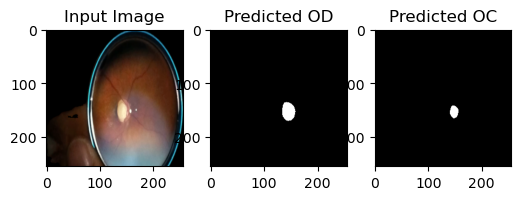

Image index: 117


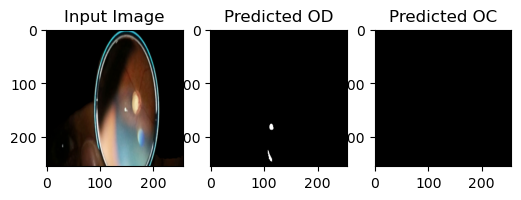

Image index: 118


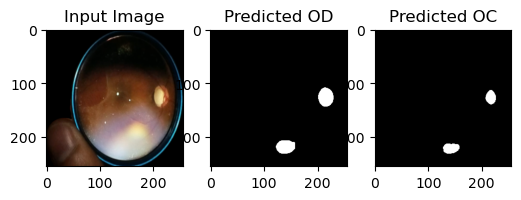

Image index: 119


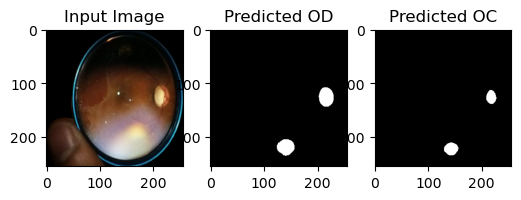

Image index: 120


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


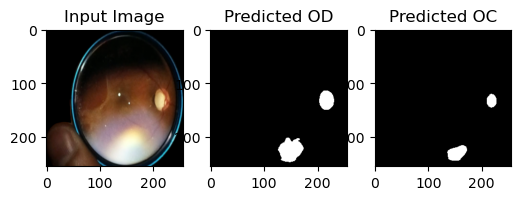

Image index: 121


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


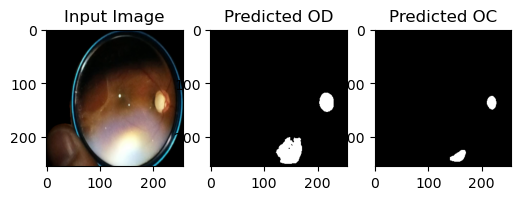

Image index: 122


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


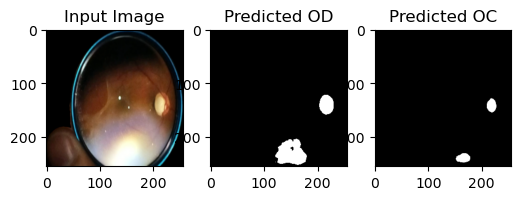

Image index: 123


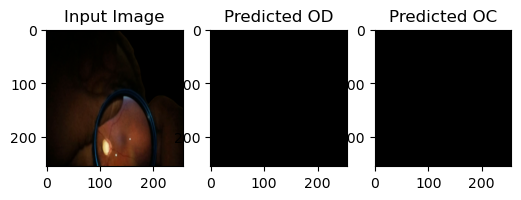

Image index: 124


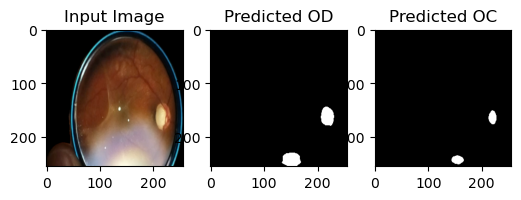

Image index: 125


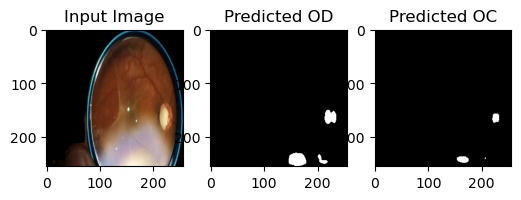

Image index: 126


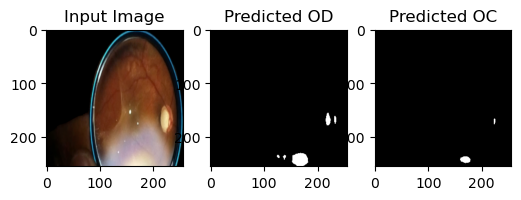

Image index: 127


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


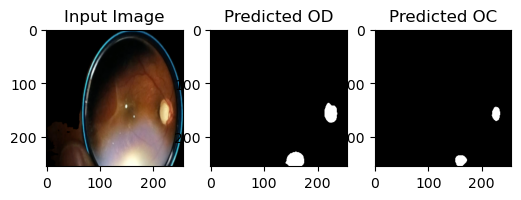

Image index: 128


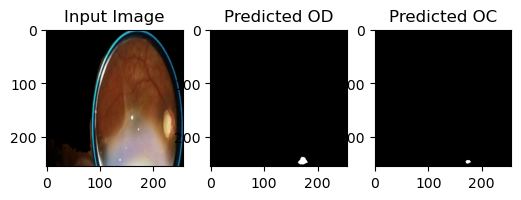

Image index: 129


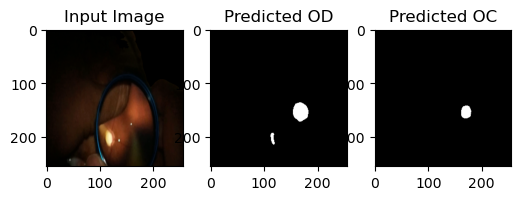

Image index: 130


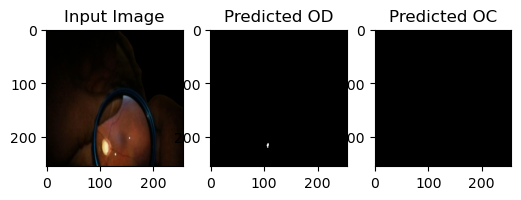

Image index: 131


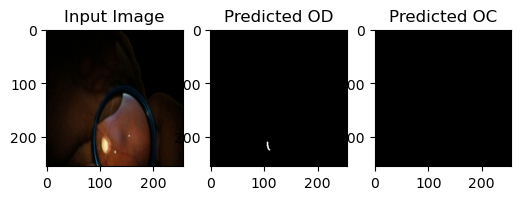

Image index: 132


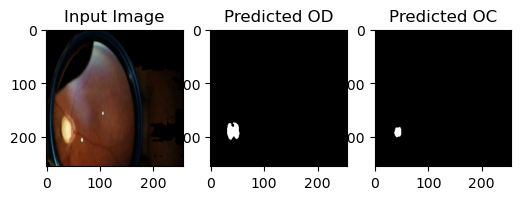

Image index: 133


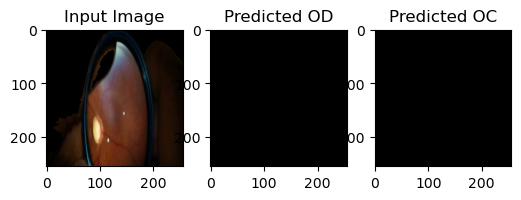

Image index: 134


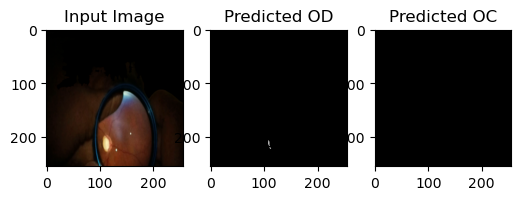

Image index: 135


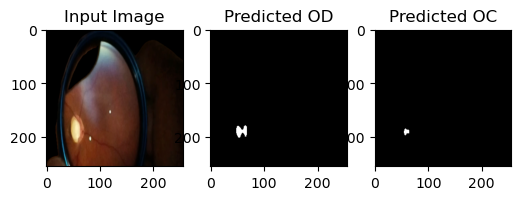

Image index: 136


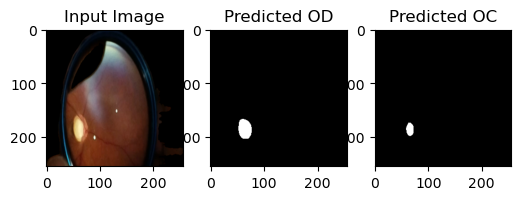

Image index: 137


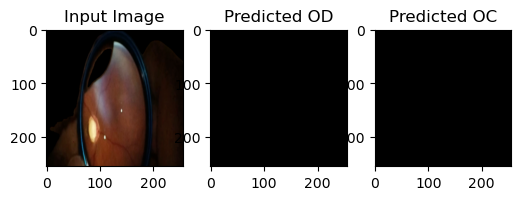

Image index: 138


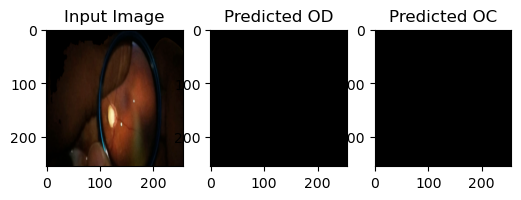

Image index: 139


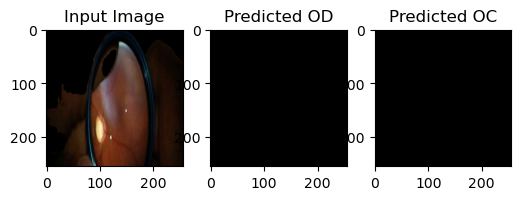

Image index: 140


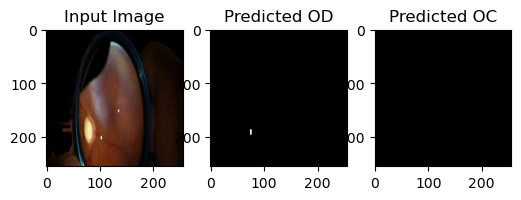

Image index: 141


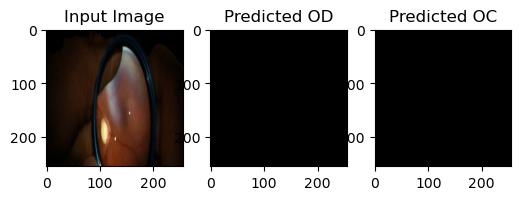

Image index: 142


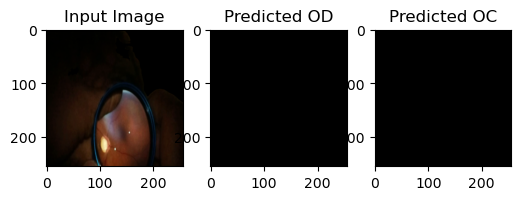

Image index: 143


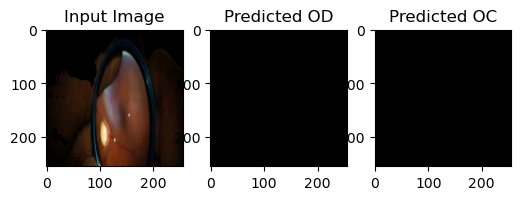

Image index: 144


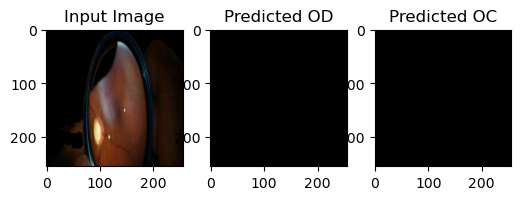

Image index: 145


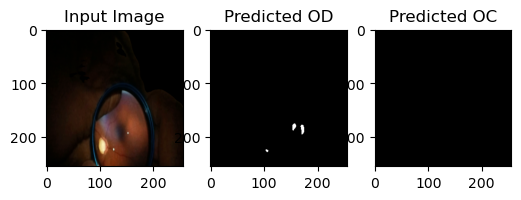

Image index: 146


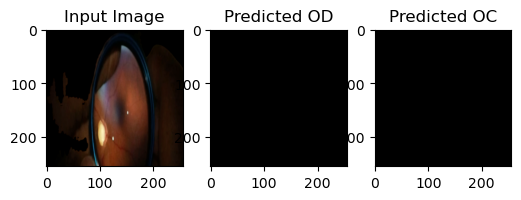

Image index: 147


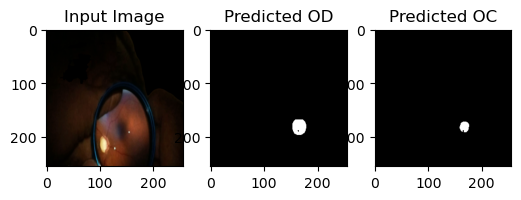

Image index: 148


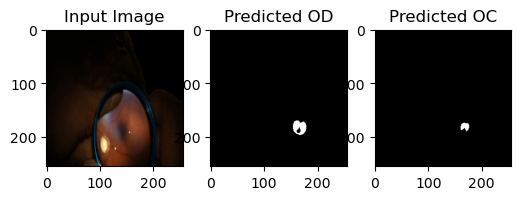

Image index: 149


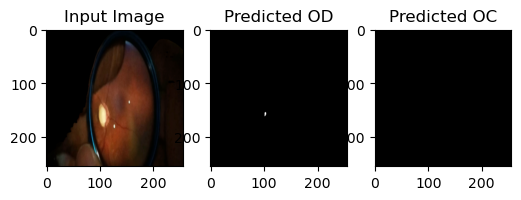

Image index: 150


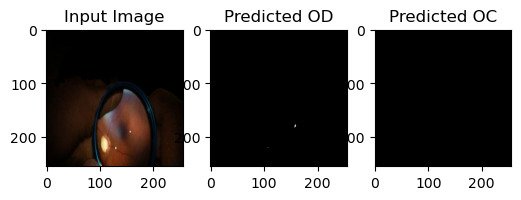

Image index: 151


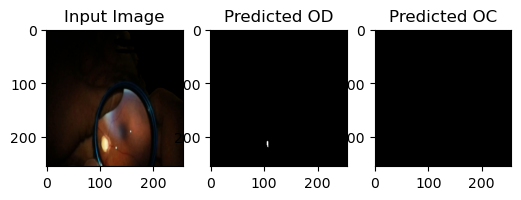

Image index: 152


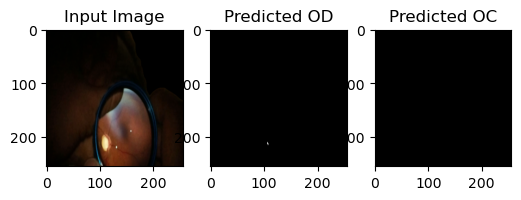

Image index: 153


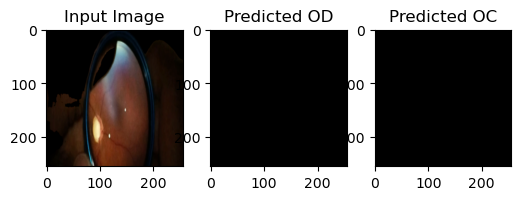

Image index: 154


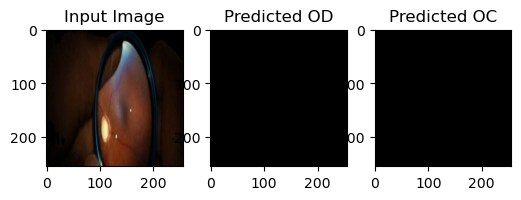

Image index: 155


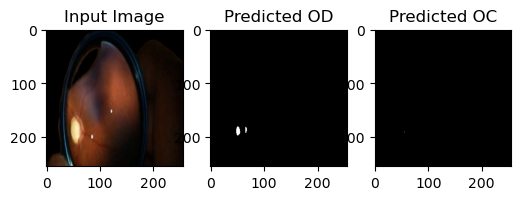

Image index: 156


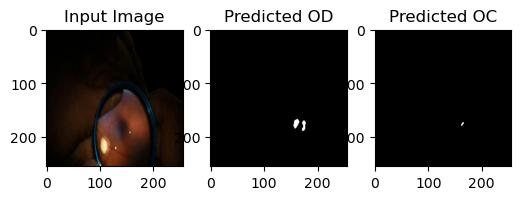

Image index: 157


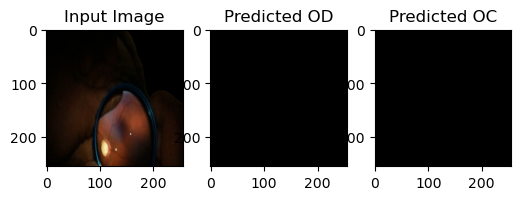

Image index: 158


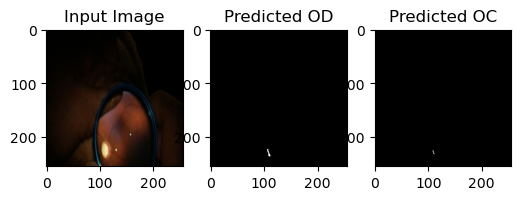

Image index: 159


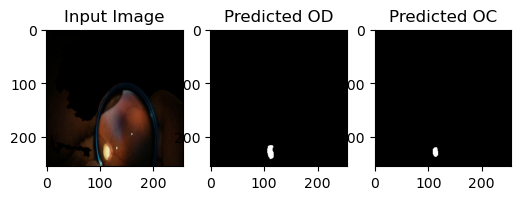

Image index: 160


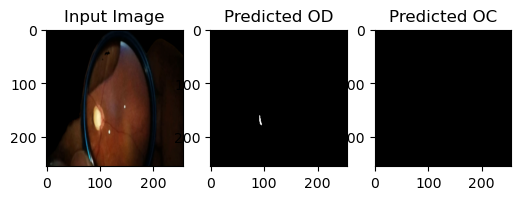

Image index: 161


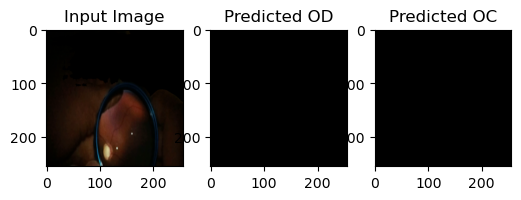

Image index: 162


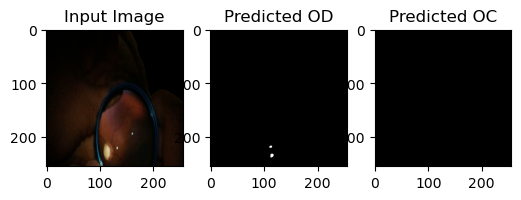

Image index: 163


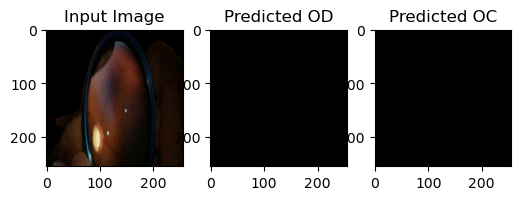

Image index: 164


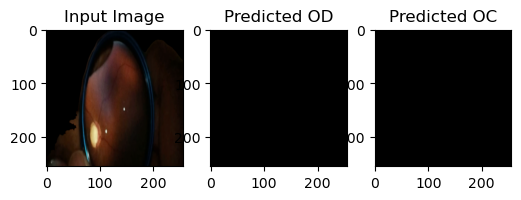

Image index: 165


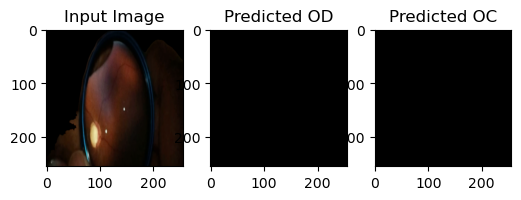

Image index: 166


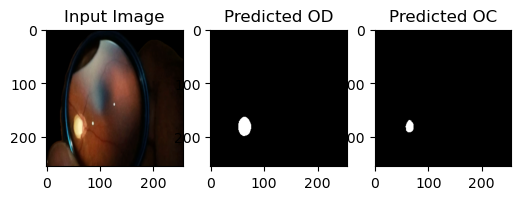

Image index: 167


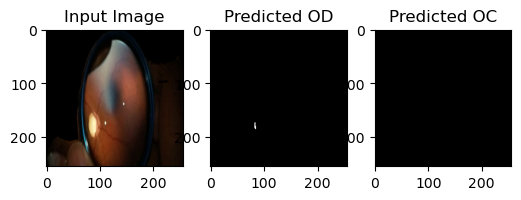

Image index: 168


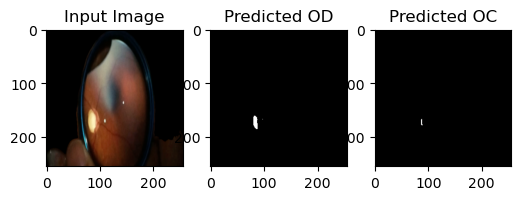

Image index: 169


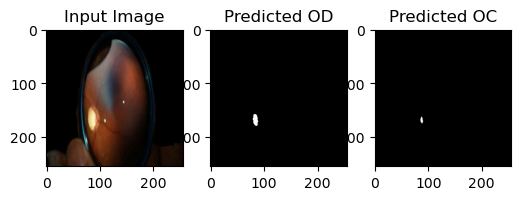

Image index: 170


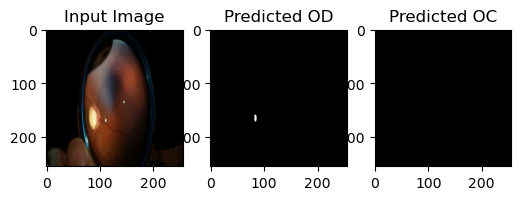

Image index: 171


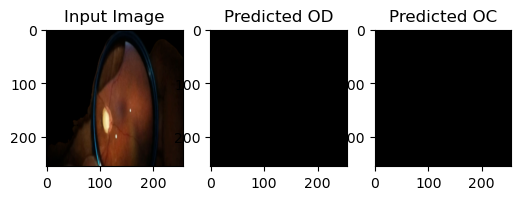

Image index: 172


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


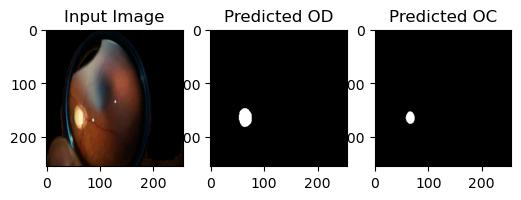

Image index: 173


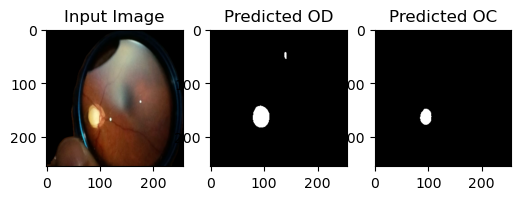

Image index: 174


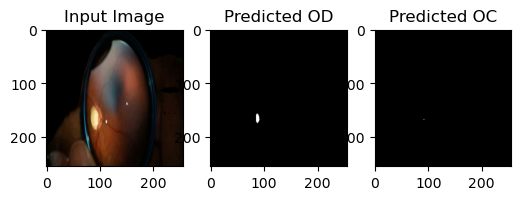

Image index: 175


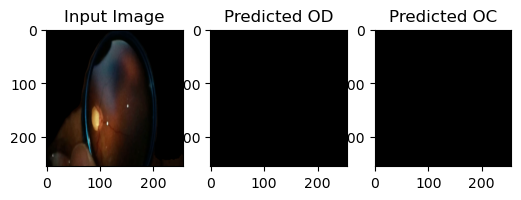

Image index: 176


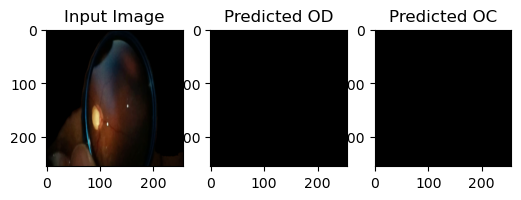

Image index: 177


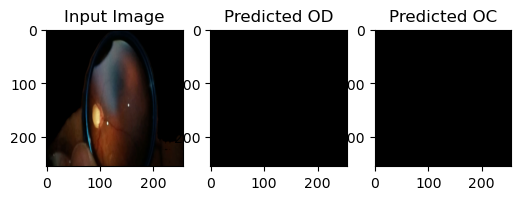

Image index: 178


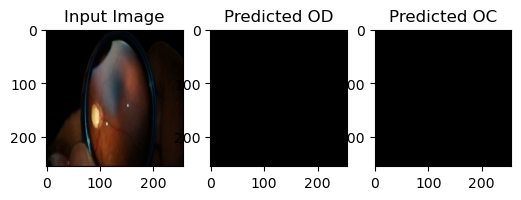

Image index: 179


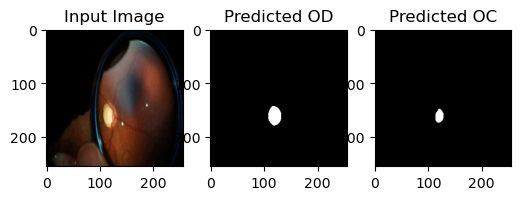

Image index: 180


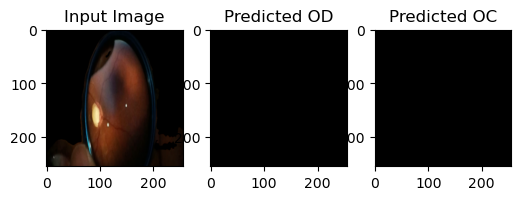

Image index: 181


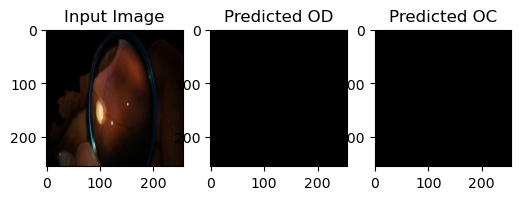

Image index: 182


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


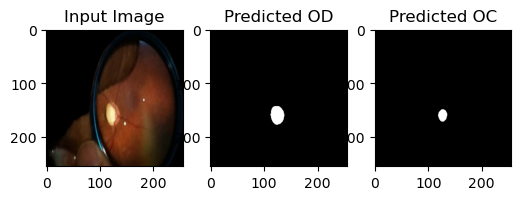

Image index: 183


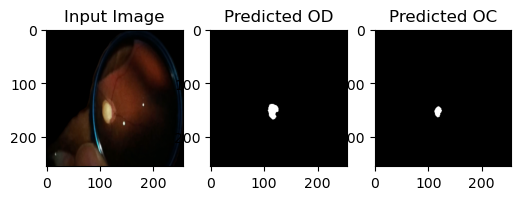

Image index: 184


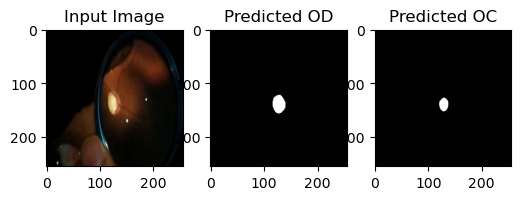

Image index: 185


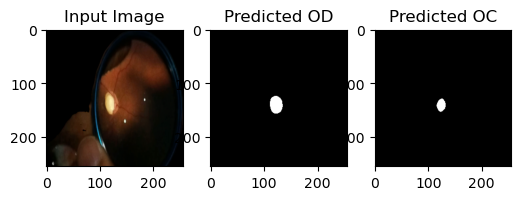

Image index: 186


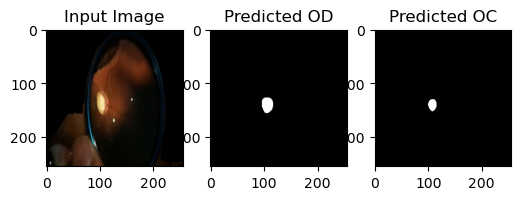

Image index: 187


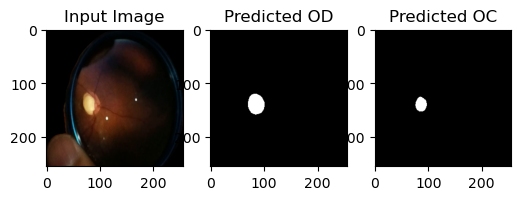

Image index: 188


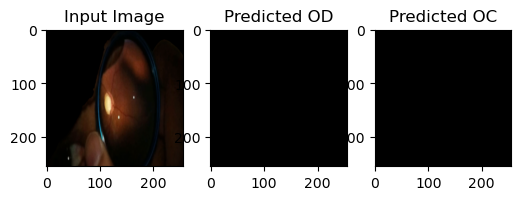

Image index: 189


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


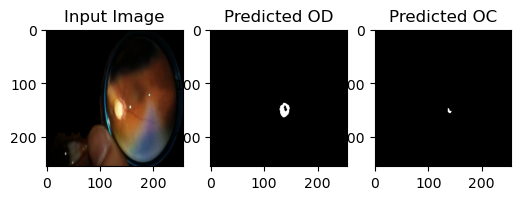

Image index: 190


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


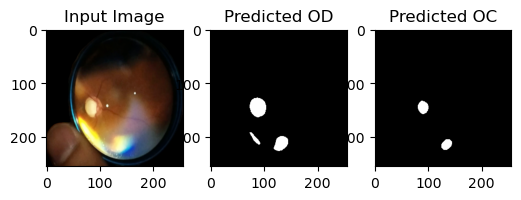

Image index: 191


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


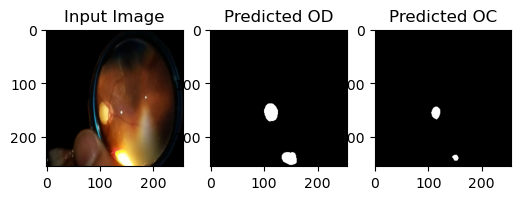

Image index: 192


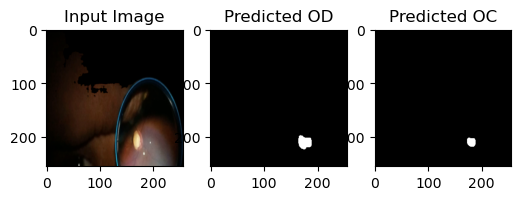

Image index: 193


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


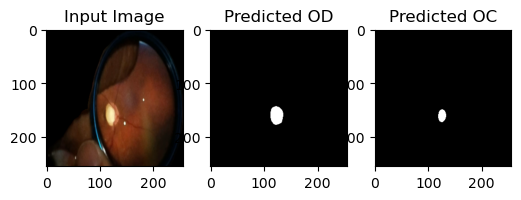

Image index: 194


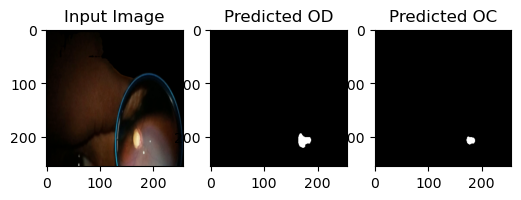

Image index: 195


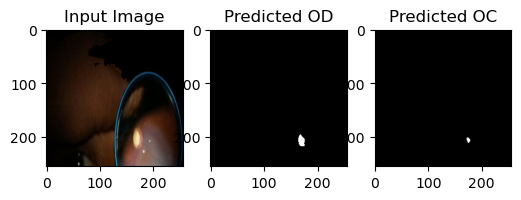

Image index: 196


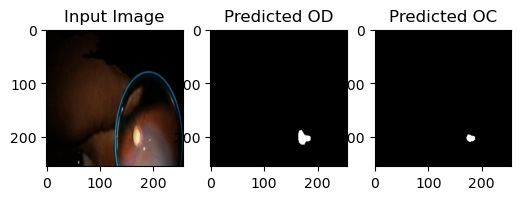

Image index: 197


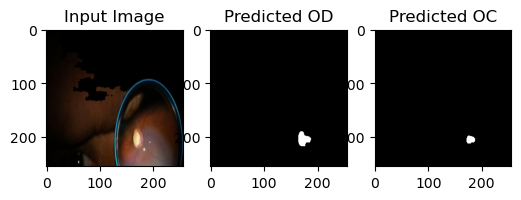

Image index: 198


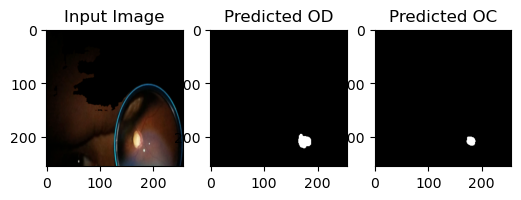

Image index: 199


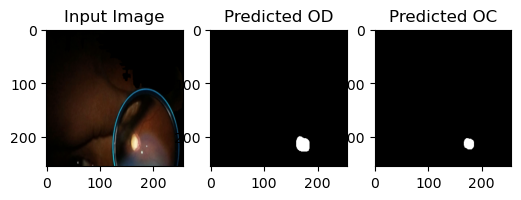

Image index: 200


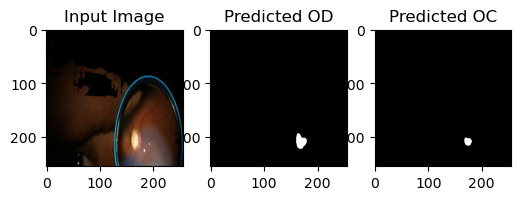

Image index: 201


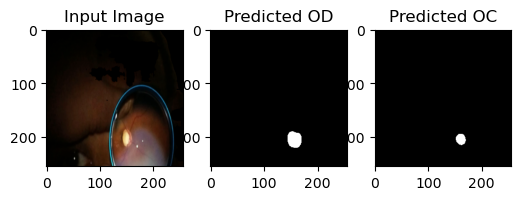

Image index: 202


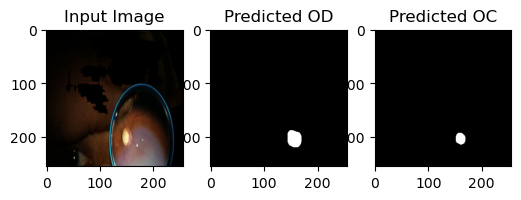

Image index: 203


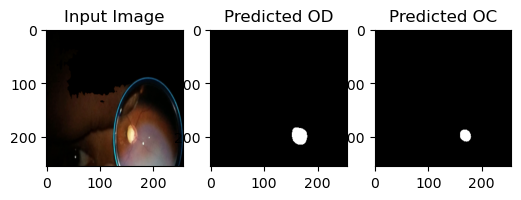

Image index: 204


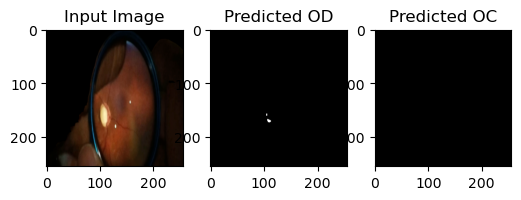

Image index: 205


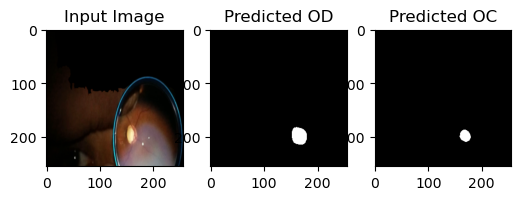

Image index: 206


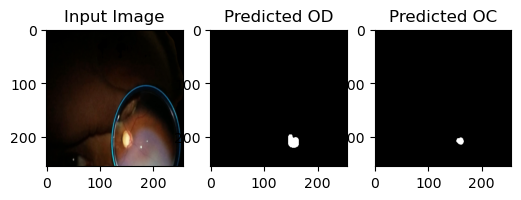

Image index: 207


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


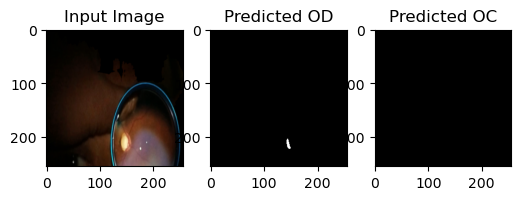

Image index: 208


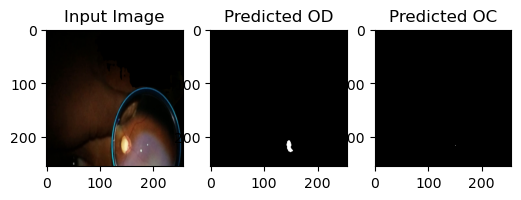

Image index: 209


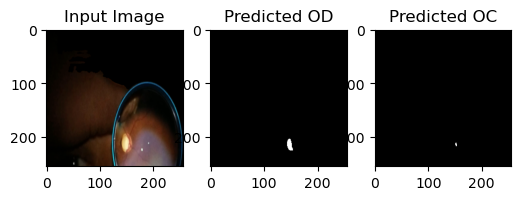

Image index: 210


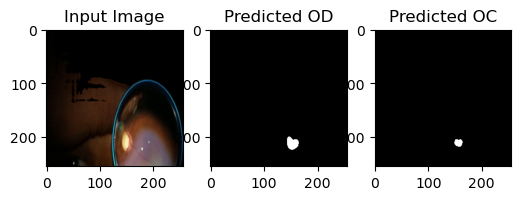

Image index: 211


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


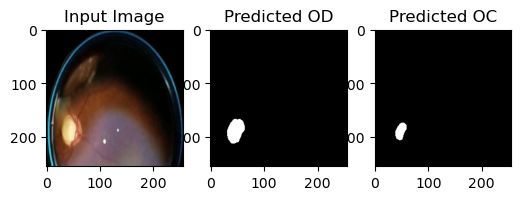

Image index: 212


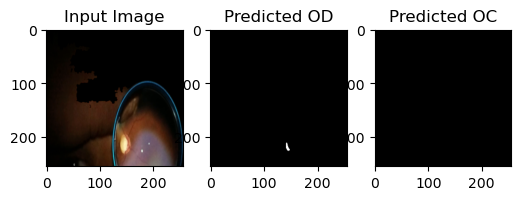

Image index: 213


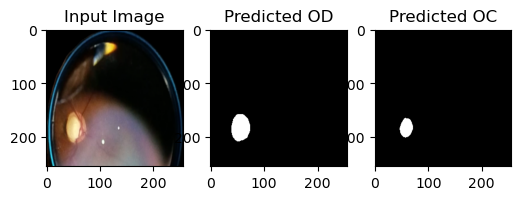

Image index: 214


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


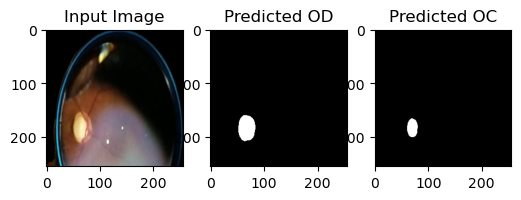

In [24]:
# Look at all predictions for subject 3
for i, img in enumerate(images_subj3):
    print(f"Image index: {i}")
    pred_od, pred_oc = predict(img, model, device)

Top predictions for subject 3:

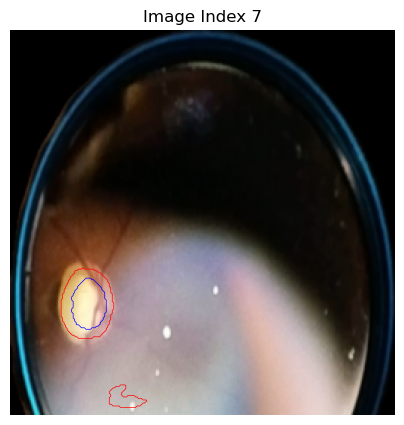

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


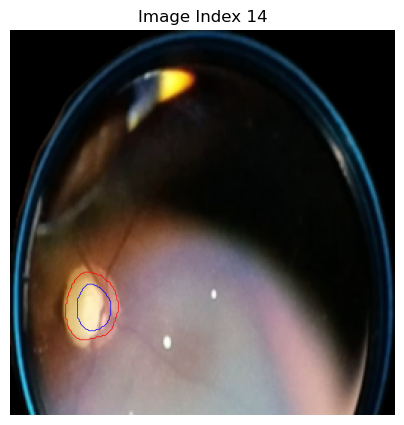

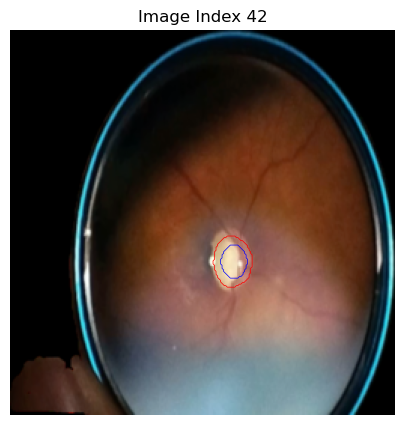

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


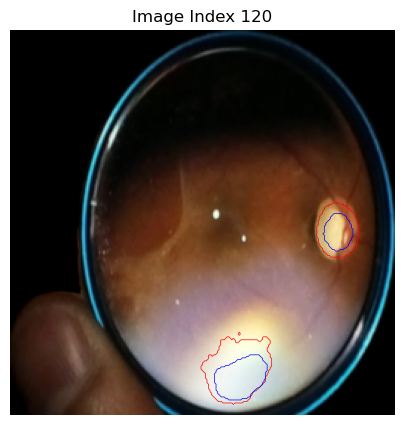

In [25]:
idxs = [7, 14, 42, 120]
for idx in idxs:
    img = images_subj3[idx]
    pred_od, pred_oc = predict(img, model, device, plot=False)
    img = img.squeeze().cpu().numpy().transpose(1,2,0)
    plt.figure(figsize=(5,5))
    plt.imshow(img)
    plt.contour(pred_od, levels=[0.5], colors="red", linewidths=0.5)
    plt.contour(pred_oc, levels=[0.5], colors="blue", linewidths=0.5)
    plt.title(f"Image Index {idx}")
    plt.axis("off")
    plt.show()